Replication of the processing of SOCCOM float and GLODAP bottle data conducted in Bronselaer et al 2020. Initially a verbatim replication, and, later, a replication with the modification that GLODAP bottles collected in regions where bathymetry < 2000 m were excluded. This script specifically replicates the supplementary figure SF2, whilst an alternative script uses the outputs of the processing described here to replicate the zonal mean figures included in the main text (F1, F2).

In [1]:
import xarray as xr
import dask.array
import numpy as np
import pandas as pd
## plotting
import matplotlib.pyplot as plt
from matplotlib import gridspec
import matplotlib.cm as pcm
import cartopy.crs as ccrs
import cartopy.feature
import matplotlib.path as mpath
import matplotlib.ticker as mticker
import matplotlib.colors as col
import sys
sys.path.append('/home/Ruth.Moorman/')
### import required python functions
from masking import *
from SOCCOM_GLODAP_processing import *
import cmocean.cm as cm
import scipy.io
import warnings
warnings.filterwarnings('ignore')
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)
from matplotlib import rc, rcParams
rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]
import nclcmaps

In [2]:
land_map = access_land_map()
shelf_map = access_shelf_map()
slope_map = access_slope_map()

In [3]:
rc('xtick', labelsize=30) 
rc('ytick', labelsize=30) 
rc('axes', labelsize=30)

### Fig S2 (original)

In [4]:
Ben_GLODAP = xr.open_dataset('/work/Ruth.Moorman/Ben-Bronselaer_SOCCOM-GLODAP-gridded-products/GLODAP_data.nc')
Ben_SOCCOM = xr.open_dataset('/work/Ruth.Moorman/Ben-Bronselaer_SOCCOM-GLODAP-gridded-products/SOCCOM_data.nc')
Ben_SOCCOM_Temp = Ben_SOCCOM.Temperature
Ben_SOCCOM_Salt = Ben_SOCCOM.Salinity
Ben_SOCCOM_Oxygen = Ben_SOCCOM.Oxygen
Ben_SOCCOM_Nitrate = Ben_SOCCOM.Nitrate
Ben_SOCCOM_DIC = Ben_SOCCOM.DIC
Ben_SOCCOM_pH = Ben_SOCCOM.pH
Ben_GLODAP_Temp = Ben_GLODAP.Temperature
Ben_GLODAP_Salt = Ben_GLODAP.Salinity
Ben_GLODAP_Oxygen = Ben_GLODAP.Oxygen
Ben_GLODAP_Nitrate = Ben_GLODAP.Nitrate
Ben_GLODAP_DIC = Ben_GLODAP.DIC
Ben_GLODAP_pH = Ben_GLODAP.pH

In [5]:
def plot_ben_grid(ax, data, cmap, lon = np.arange(0,364,8), lat = np.arange(-90,-30,3)):
    lat_north = -29
    ax.set_extent([-180, 180, -90, lat_north], ccrs.PlateCarree())
    ax.contour(land_map.sel(yt_ocean = slice(-90,lat_north)).xt_ocean, land_map.sel(yt_ocean = slice(-90,lat_north)).yt_ocean,land_map.sel(yt_ocean = slice(-90,lat_north)),[0,1], colors = 'k', alpha = 1, transform=ccrs.PlateCarree())
    temp = ax.pcolormesh(lon, lat,data,cmap = cmap, norm =norm, transform = ccrs.PlateCarree())
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    gl = ax.gridlines(linewidth = 1, color = 'grey', linestyle = '--', alpha = 0.3)
    gl.ylocator = mticker.FixedLocator(np.arange(-90,-30,3))
    gl.xlocator = mticker.FixedLocator(np.arange(0,364,8))
    return temp

In [6]:
depth = Ben_SOCCOM.depth.values
depth_bin_bounds = np.array([2.5,5.5,8.5,15.5,22.5,29.5,40.5,53.5,76.5,105.5,146.5,211.5,286.5,405.5,530.5,697.5,846.5,1047.5,1198.5,1397.5,1550.5,1747.5,1902.5,2097.5,])
dzt = np.diff(depth_bin_bounds)
dzt = xr.DataArray(dzt, dims = 'depth', coords={'depth':depth})

In [7]:
def upper_1000m_depthmean(var, dzt):
    var_1000m = (var.sel(depth = slice(None,1000))*dzt.sel(depth = slice(None,1000))).sum(dim = 'depth')/(dzt * (var * 0 + 1)).sel(depth = slice(None,1000)).sum(dim = 'depth')
    var_1000m = var_1000m.where(var_1000m !=0)
    return var_1000m

In [8]:
Ben_SOCCOM_Temp_1000m = upper_1000m_depthmean(Ben_SOCCOM_Temp, dzt)
Ben_SOCCOM_Salt_1000m = upper_1000m_depthmean(Ben_SOCCOM_Salt, dzt)
Ben_SOCCOM_Oxygen_1000m = upper_1000m_depthmean(Ben_SOCCOM_Oxygen, dzt)
Ben_SOCCOM_Nitrate_1000m = upper_1000m_depthmean(Ben_SOCCOM_Nitrate, dzt)
Ben_SOCCOM_DIC_1000m = upper_1000m_depthmean(Ben_SOCCOM_DIC, dzt)
Ben_SOCCOM_pH_1000m = upper_1000m_depthmean(Ben_SOCCOM_pH, dzt)
Ben_GLODAP_Temp_1000m = upper_1000m_depthmean(Ben_GLODAP_Temp, dzt)
Ben_GLODAP_Salt_1000m = upper_1000m_depthmean(Ben_GLODAP_Salt, dzt)
Ben_GLODAP_Oxygen_1000m = upper_1000m_depthmean(Ben_GLODAP_Oxygen, dzt)
Ben_GLODAP_Nitrate_1000m = upper_1000m_depthmean(Ben_GLODAP_Nitrate, dzt)
Ben_GLODAP_DIC_1000m = upper_1000m_depthmean(Ben_GLODAP_DIC, dzt)
Ben_GLODAP_pH_1000m = upper_1000m_depthmean(Ben_GLODAP_pH, dzt)

In [9]:
Ben_anomaly_Temp = Ben_SOCCOM_Temp_1000m - Ben_GLODAP_Temp_1000m
Ben_anomaly_Salt = Ben_SOCCOM_Salt_1000m - Ben_GLODAP_Salt_1000m
Ben_anomaly_Oxygen = Ben_SOCCOM_Oxygen_1000m - Ben_GLODAP_Oxygen_1000m
Ben_anomaly_Nitrate = Ben_SOCCOM_Nitrate_1000m - Ben_GLODAP_Nitrate_1000m
Ben_anomaly_DIC = Ben_SOCCOM_DIC_1000m - Ben_GLODAP_DIC_1000m
Ben_anomaly_pH = Ben_SOCCOM_pH_1000m - Ben_GLODAP_pH_1000m

In [10]:
Ben_error = xr.open_dataset('/work/Ruth.Moorman/Ben-Bronselaer_SOCCOM-GLODAP-gridded-products/error_data.nc')
Temp_error = Ben_error.Temp_total_error
Salt_error = Ben_error.Salt_total_error
Nitrate_error = Ben_error.NO_total_error
Oxygen_error = Ben_error.O2_total_error
pH_error = Ben_error.pH_total_error
DIC_error = Ben_error.DIC_total_error

Temp_error_1000m = upper_1000m_depthmean(Temp_error, dzt)
Salt_error_1000m = upper_1000m_depthmean(Salt_error, dzt)
Nitrate_error_1000m = upper_1000m_depthmean(Nitrate_error, dzt)
Oxygen_error_1000m = upper_1000m_depthmean(Oxygen_error, dzt)
pH_error_1000m = upper_1000m_depthmean(pH_error, dzt)
DIC_error_1000m = upper_1000m_depthmean(DIC_error, dzt)


Temp_sig_threshold_1000m = 1.65 * Temp_error_1000m
Salt_sig_threshold_1000m = 1.65 * Salt_error_1000m
Nitrate_sig_threshold_1000m = 1.65 * Nitrate_error_1000m
Oxygen_sig_threshold_1000m = 1.65 * Oxygen_error_1000m
pH_sig_threshold_1000m = 1.65 * pH_error_1000m
DIC_sig_threshold_1000m = 1.65 * DIC_error_1000m

sig_anomaly_Temp_1000m = Ben_anomaly_Temp.where(np.abs(Ben_anomaly_Temp)<Temp_sig_threshold_1000m) * 0 +1
sig_anomaly_Salt_1000m = Ben_anomaly_Salt.where(np.abs(Ben_anomaly_Salt)<Salt_sig_threshold_1000m) * 0 +1
sig_anomaly_Nitrate_1000m = Ben_anomaly_Nitrate.where(np.abs(Ben_anomaly_Nitrate)<Nitrate_sig_threshold_1000m) * 0 +1
sig_anomaly_Oxygen_1000m = Ben_anomaly_Oxygen.where(np.abs(Ben_anomaly_Oxygen)<Oxygen_sig_threshold_1000m) * 0 +1
sig_anomaly_pH_1000m = Ben_anomaly_pH.where(np.abs(Ben_anomaly_pH)<pH_sig_threshold_1000m) * 0 +1
sig_anomaly_DIC_1000m = Ben_anomaly_DIC.where(np.abs(Ben_anomaly_DIC)<DIC_sig_threshold_1000m) * 0 +1


In [11]:
nans = np.zeros((20,1))
nans[:] = np.nan
extention = xr.DataArray(nans, coords = [Ben_anomaly_Temp.latitude, np.array([356])], dims = ['latitude', 'longitude'])
Ben_anomaly_Temp = xr.concat([Ben_anomaly_Temp,extention], dim='longitude')
Ben_anomaly_Salt = xr.concat([Ben_anomaly_Salt,extention], dim='longitude')
Ben_anomaly_Oxygen = xr.concat([Ben_anomaly_Oxygen,extention], dim='longitude')
Ben_anomaly_Nitrate = xr.concat([Ben_anomaly_Nitrate,extention], dim='longitude')
Ben_anomaly_DIC = xr.concat([Ben_anomaly_DIC,extention], dim='longitude')
Ben_anomaly_pH = xr.concat([Ben_anomaly_pH,extention], dim='longitude')

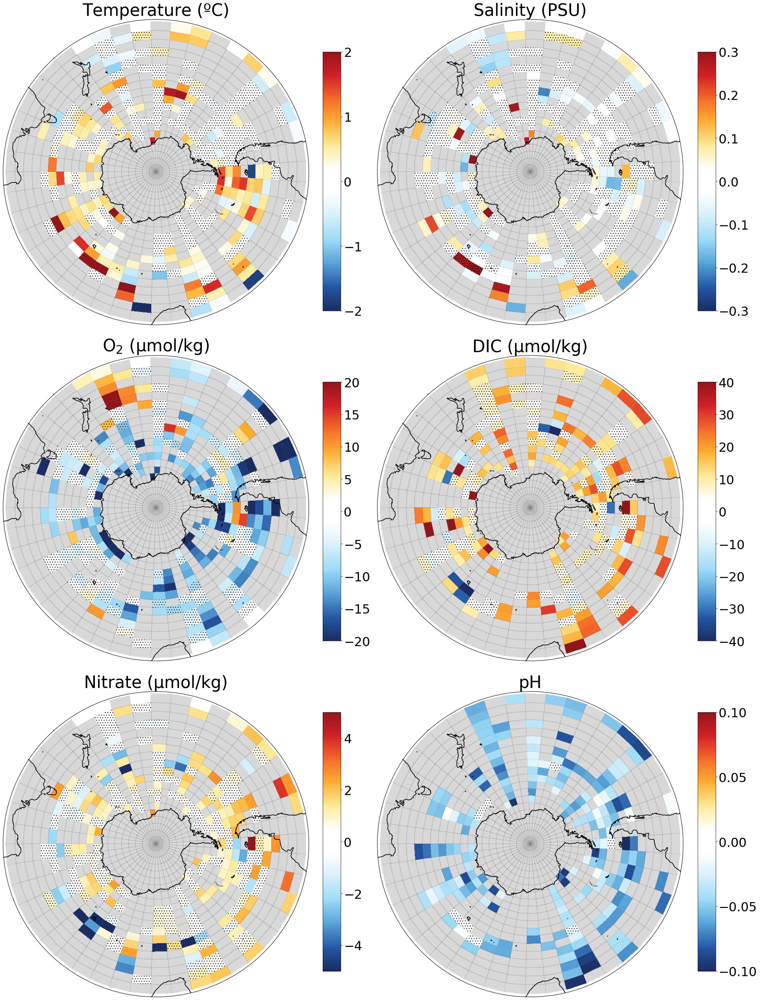

In [12]:
# temp only, for powerpoint
fig = plt.figure(figsize=[30, 43])
gs = gridspec.GridSpec(3,2)
proj = ccrs.Stereographic(central_longitude=-150,central_latitude=-90)
ax, ax1, ax2, ax3, ax4, ax5 = plt.subplot(gs[0,0], projection =proj), plt.subplot(gs[0,1], projection =proj), plt.subplot(gs[1,0], projection =proj),plt.subplot(gs[1,1], projection =proj),plt.subplot(gs[2,0], projection =proj),plt.subplot(gs[2,1], projection =proj)
gs.update(wspace = 0.15, hspace = 0.1)

cmap = nclcmaps.cmap('BlueWhiteOrangeRed')
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=2) 
temp = plot_ben_grid(ax, Ben_anomaly_Temp, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax.pcolor(np.arange(0,360,8),np.arange(-90,-30,3),sig_anomaly_Temp_1000m, hatch='..', alpha = 0,transform = ccrs.PlateCarree())
ax.set_title('Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.49, 0.655, 0.02, 0.2])
cbar=plt.colorbar(temp,cax = cax,orientation='vertical',shrink = 0.5, ticks = [-2,-1,0,1,2])

norm = col.Normalize(vmin=-0.3,vmax=0.3) 
salt = plot_ben_grid(ax1, Ben_anomaly_Salt, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax1.pcolor(np.arange(0,360,8),np.arange(-90,-30,3),sig_anomaly_Salt_1000m, hatch='..', alpha = 0,transform = ccrs.PlateCarree())
ax1.set_title('Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.905, 0.655, 0.02, 0.2])
cbar=plt.colorbar(salt,cax = cax,orientation='vertical',shrink = 0.5, ticks = [-0.3,-0.2,-0.1,0,0.1,0.2,0.3])

norm = col.Normalize(vmin=-20,vmax=20) 
oxygen = plot_ben_grid(ax2, Ben_anomaly_Oxygen, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax2.pcolor(np.arange(0,360,8),np.arange(-90,-30,3),sig_anomaly_Oxygen_1000m, hatch='..', alpha = 0,transform = ccrs.PlateCarree())
ax2.set_title('O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.49, 0.4, 0.02, 0.2])
cbar=plt.colorbar(oxygen,cax = cax,orientation='vertical',shrink = 0.5, ticks = [-20,-15,-10,-5,0,5,10,15,20])

norm = col.Normalize(vmin=-40,vmax=40) 
dic = plot_ben_grid(ax3, Ben_anomaly_DIC, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax3.pcolor(np.arange(0,360,8),np.arange(-90,-30,3),sig_anomaly_DIC_1000m, hatch='..', alpha = 0,transform = ccrs.PlateCarree())
ax3.set_title('DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.905, 0.4, 0.02, 0.2])
cbar=plt.colorbar(dic,cax = cax,orientation='vertical',shrink = 0.5, ticks = [-40,-30,-20,-10,0,10,20,30,40])

norm = col.Normalize(vmin=-5,vmax=5) 
nitrate = plot_ben_grid(ax4, Ben_anomaly_Nitrate, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax4.pcolor(np.arange(0,360,8),np.arange(-90,-30,3),sig_anomaly_Nitrate_1000m, hatch='..', alpha = 0,transform = ccrs.PlateCarree())
ax4.set_title('Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.49, 0.145, 0.02, 0.2])
cbar=plt.colorbar(nitrate,cax = cax,orientation='vertical',shrink = 0.5, ticks = [-4,-2,0,2,4])

norm = col.Normalize(vmin=-0.1,vmax=0.1) 
pH = plot_ben_grid(ax5, Ben_anomaly_pH, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax5.pcolor(np.arange(0,360,8),np.arange(-90,-30,3),sig_anomaly_pH_1000m, hatch='..', alpha = 0,transform = ccrs.PlateCarree())
ax5.set_title('pH', fontsize = 40)
cax = fig.add_axes([0.905, 0.145, 0.02, 0.2])
cbar=plt.colorbar(pH,cax = cax,orientation='vertical',shrink = 0.5, ticks = [-0.1,-0.05,0,0.05,0.1])

# figurepath = 'save_plot.png'
# plt.savefig(figurepath, dpi=None, facecolor='w', edgecolor='w',orientation='portrait', papertype=None, format='png',transparent=False, bbox_inches='tight', pad_inches=0.1,frameon=None)


plt.show()

## Replication of the analysis - SOCCOM

So the basic procedure is:

1. Obtain all SOCCOM float data (I'm using the LR data LIAR carbon methods from https://soccompu.princeton.edu/www/index.html) and interpolate each QC cleared profile onto a fine vertical grid (I used a 1m grid from the surface to 2000 m depth) to standardise file formats and make the data more easily manipulated. Following Ben, I use 4 interpolation methods (nearest neighbour, cubic spline, quadratic spline and linear) so that later we have some estimate of the effect of chosen interpolation methods on the final result.

 - 1.1. A little sub-step here is that spline methods can result in instabilities! I do a QC step wherein I chuck out any profiles where anomalies between spline interpolated profiles and linearly interpolated profiles exceed a manually selected threshold. Threshold value is subjective, they were chosen by manually inspecting profiles with different spline minus linear anomalies.


2. Reload all QCed and interpolated data, do any temporal slicing necessary (e.g. when replicating Ben's analysis precisely, we only want profiles prior to April 2019) and vertically average interpolated values onto Ben's 23 level vertical grid (or any other grid of your chosing...the grid of whatever model you plan to compare to might make sense!).


3. For each month, bin all profiles into your horizontal grid of choice (here it's a 3º lat by 8º lon mesh) and average profiles within a given grid cell. This gives you a climatology of a float gridded product. The time mean of said climatology is your final SOCCOM era product.


Along the way I try to reatin as amuch metadata as possible to allow for analysis of confounding factors.

### Step 1: vertical interpolation and gridding.

In [13]:
help(interpolated_SOCCOM_floats) # from the .py file SOCCOM_GLODAP_processing

Help on function interpolated_SOCCOM_floats in module SOCCOM_GLODAP_processing:

interpolated_SOCCOM_floats(variable, float_dir, float_str, float_end='SOOCNQC.nc')
    Aggregates all SOCCOM float data from files float_dir/float_str+float_end(e.g. '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/0037SOOCNQC.nc') into a single xarray datastructure with dimensions N_PROF and depth.
    depth_bin dimension is determined interpolating SOCCOM float data onto a 2001 level 1m grid [0,1,...,2000] using 4 interpolation methods: linear, nearest neighbour, cubic spline and quadratic spline (so later uncertainty associated with the interpolation method may be quantified)
    
    float_str will be an array of strings designating files for different floats e.g ['11090', '12545', '12733', '12784'...]
    variable is a string that is set to one of the following:
    
    Temperature
    Salinity
    Sigma_theta
    Oxygen
    Nitrate
    Chl_a
    POC
    TALK
    DIC
    
    will return 4 DataAr

In [14]:
float_str = np.array(['0037',  '0511',  '0569',  '0691','0506',  '0564',  '0570',  '0692','0507',  '0565',  '0571',  '0693','0508',  '0566',  '0688',  '0886','0509',  '0567',  '0689',  '0888','0510',  '0568',  '0690',  '0889','11090',  '12545',  '12733',  '12784',  '8501',  '9634', '12361',  '12549',  '12734',  '12786',  '8514',  '9637', '12363',  '12551',  '12736',  '12787',  '9018',  '9642', '12366',  '12552',  '12739',  '12878',  '9031',  '9645', '12369',  '12558',  '12741',  '12879',  '9091',  '9646', '12370',  '12559',  '12742',  '12880',  '9092',  '9650', '12371',  '12573',  '12744',  '12881',  '9094',  '9652', '12372',  '12575',  '12745',  '12882',  '9095',  '9655', '12379',  '12688',  '12747',  '12883',  '9096',  '9657', '12380',  '12696',  '12748',  '12884',  '9099',  '9659', '12381',  '12700',  '12749',  '12885',  '9101',  '9660', '12382',  '12701',  '12752',  '12886',  '9125',  '9662', '12386',  '12702',  '12754',  '12888',  '9254',  '9666', '12388',  '12707',  '12755',  '12889',  '9260',  '9668', '12390',  '12708',  '12757',  '12892',  '9265',  '9744', '12396',  '12709',  '12758',  '6091',  '9275',  '9749', '12398',  '12711',  '12768',  '7557',  '9313',  '9750', '12537',  '12714',  '12769',  '7567',  '9600',  '9752', '12540',  '12723',  '12778',  '7613',  '9602',  '9757', '12541',  '12727',  '12779',  '7614',  '9630',  '9762', '12542',  '12729',  '12781',  '7652',  '9631',  '9766', '12543',  '12730',  '12782',  '8204',   '9632'])
float_dir = '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/processed_SOCCOM/'

Run previously:

In [ ]:
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolated_SOCCOM_floats('Temperature', float_dir, float_str, float_end='SOOCNQC.nc')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All float Temp interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_FLOATS_TEMPERATURE-vertically-interpolated-preQC.nc')


In [ ]:
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolated_SOCCOM_floats('Salinity', '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/', float_str, float_end='SOOCNQC.nc')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All float Salt interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_FLOATS_SALINITY-vertically-interpolated-preQC.nc')


In [ ]:
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolated_SOCCOM_floats('Sigma_theta', '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/', float_str, float_end='SOOCNQC.nc')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All float Sigma_theta interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_FLOATS_SIGMA_THETA-vertically-interpolated-preQC.nc')


In [ ]:
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolated_SOCCOM_floats('Oxygen', '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/', float_str, float_end='SOOCNQC.nc')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All float Oxygen interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_FLOATS_OXYGEN-vertically-interpolated-preQC.nc')

In [ ]:
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolated_SOCCOM_floats('Nitrate', '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/', float_str, float_end='SOOCNQC.nc')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All float Nitrate interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_FLOATS_NITRATE-vertically-interpolated-preQC.nc')

In [ ]:
DIC_float_str = np.array(['0511',  '0569',  '0691','0506',  '0564',  '0570',  '0692','0507',  '0565',  '0571',  '0693','0508',  '0566',  '0688',  '0886','0509',  '0567',  '0689',  '0888','0510',  '0568',  '0690',  '0889','11090',  '12545',  '12733',  '12784',  '8501',  '9634', '12361',  '12549',  '12734',  '12786',  '8514',  '9637', '12363',  '12551',  '12736',  '12787',  '9018',  '9642', '12366',  '12552',  '12739',  '12878',  '9031',  '9645', '12369',  '12558',  '12741',  '12879',  '9091',  '9646', '12370',  '12559',  '12742',  '12880',  '9092',  '9650', '12371',  '12573',  '12744',  '12881',  '9094',  '9652', '12372',  '12575',  '12745',  '12882',  '9095',  '9655', '12379',  '12688',  '12747',  '12883',  '9096',  '9657', '12380',  '12696',  '12748',  '12884',  '9099',  '9659', '12381',  '12700',  '12749',  '12885',  '9101',  '9660', '12382',  '12701',  '12752',  '12886',  '9125',  '9662', '12386',  '12702',  '12754',  '12888',  '9254',  '9666', '12388',  '12707',  '12755',  '12889',  '9260',  '9668', '12390',  '12708',  '12757',  '12892',  '9265',  '9744', '12396',  '12709',  '12758',  '9275',  '9749', '12398',  '12711',  '12768',  '9313',  '9750', '12537',  '12714',  '12769',  '9600',  '9752', '12540',  '12723',  '12778',  '9602',  '9757', '12541',  '12727',  '12779',  '9630',  '9762', '12542',  '12729',  '12781',  '9631',  '9766', '12543',  '12730',  '12782',  '8204',   '9632'])
# not all floats measure DIC

In [ ]:
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolated_SOCCOM_floats('DIC', '/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/', DIC_float_str, float_end='SOOCNQC.nc')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All float DIC interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_FLOATS_DIC-vertically-interpolated-preQC.nc')

The above funciton has been run for all SOCCOM variables in Ben's analysis excepting pH (can't just volume average ph) and saved in the following location:

`/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/ALL_FLOATS_DIC-vertically-interpolated_preQC.nc`

`/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/ALL_FLOATS_NITRATE-vertically-interpolated_preQC.nc`

`/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/ALL_FLOATS_OXYGEN-vertically-interpolated_preQC.nc`

`/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/ALL_FLOATS_SALINITY-vertically-interpolated_preQC.nc`

`/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/ALL_FLOATS_SIGMA-THETA-vertically-interpolated_preQC.nc`

`/work/Ruth.Moorman/SOCCOM-floats/LR_SOCCOM_20200308/ALL_FLOATS_TEMPERATURE-vertically-interpolated_preQC.nc`

I then removed profiles where the spline interpolations introduced anomalies (relative to the linear interpolation method) of a magnitude greater than:
- Temp: 1ºC
- Salt: 0.15 PSU
- Sigma: 0.3 kg/m3
- Oxygen: 15 µmol/kg
- Nitrate: 2 µmol/kg
- DIC: 10 µmol/kg

In [252]:
ds = xr.open_dataset(float_dir+'ALL_FLOATS_TEMPERATURE-vertically-interpolated-preQC.nc')
temp_linear= ds.linear
temp_nearest= ds.nearest
temp_cubic= ds.cubic
temp_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_FLOATS_SALINITY-vertically-interpolated-preQC.nc')
salt_linear= ds.linear
salt_nearest= ds.nearest
salt_cubic= ds.cubic
salt_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_FLOATS_SIGMA_THETA-vertically-interpolated-preQC.nc')
sigma_linear= ds.linear
sigma_nearest= ds.nearest
sigma_cubic= ds.cubic
sigma_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_FLOATS_OXYGEN-vertically-interpolated-preQC.nc')
oxygen_linear= ds.linear
oxygen_nearest= ds.nearest
oxygen_cubic= ds.cubic
oxygen_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_FLOATS_NITRATE-vertically-interpolated-preQC.nc')
nitrate_linear= ds.linear
nitrate_nearest= ds.nearest
nitrate_cubic= ds.cubic
nitrate_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_FLOATS_DIC-vertically-interpolated-preQC.nc')
dic_linear= ds.linear
dic_nearest= ds.nearest
dic_cubic= ds.cubic
dic_quad= ds.quad

In [253]:
# total profiles before QC
len(temp_linear.N_PROF)

14500

In [195]:
threshold = 1
cubic_error_indices = temp_cubic.where(np.abs(temp_cubic-temp_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = temp_quad.where(np.abs(temp_quad-temp_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
temp_linear[interp_error_profiles,:] = np.nan
temp_cubic[interp_error_profiles,:] = np.nan
temp_quad[interp_error_profiles,:] = np.nan
temp_nearest[interp_error_profiles,:] = np.nan
temp_linear = temp_linear.where(np.abs(temp_linear)>0,drop = True)
temp_cubic = temp_cubic.where(np.abs(temp_cubic)>0,drop = True)
temp_quad = temp_quad.where(np.abs(temp_quad)>0,drop = True)
temp_nearest = temp_nearest.where(np.abs(temp_nearest)>0,drop = True)
ds = xr.Dataset({'linear':temp_linear, 'nearest': temp_nearest, 'cubic':temp_cubic, 'quad': temp_quad})
ds.attrs['description'] = 'All float Temp interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_FLOATS_TEMPERATURE-vertically-interpolated-QC.nc')

Drop 60 profiles


In [196]:
threshold = 0.15
cubic_error_indices = salt_cubic.where(np.abs(salt_cubic-salt_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = salt_quad.where(np.abs(salt_quad-salt_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
salt_linear[interp_error_profiles,:] = np.nan
salt_cubic[interp_error_profiles,:] = np.nan
salt_quad[interp_error_profiles,:] = np.nan
salt_nearest[interp_error_profiles,:] = np.nan
salt_linear = salt_linear.where(np.abs(salt_linear)>0,drop = True)
salt_cubic = salt_cubic.where(np.abs(salt_cubic)>0,drop = True)
salt_quad = salt_quad.where(np.abs(salt_quad)>0,drop = True)
salt_nearest = salt_nearest.where(np.abs(salt_nearest)>0,drop = True)
ds = xr.Dataset({'linear':salt_linear, 'nearest': salt_nearest, 'cubic':salt_cubic, 'quad': salt_quad})
ds.attrs['description'] = 'All float Salinity interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_FLOATS_SALINITY-vertically-interpolated-QC.nc')

Drop 59 profiles


In [197]:
threshold = 15
cubic_error_indices = oxygen_cubic.where(np.abs(oxygen_cubic-oxygen_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = oxygen_quad.where(np.abs(oxygen_quad-oxygen_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
oxygen_linear[interp_error_profiles,:] = np.nan
oxygen_cubic[interp_error_profiles,:] = np.nan
oxygen_quad[interp_error_profiles,:] = np.nan
oxygen_nearest[interp_error_profiles,:] = np.nan
oxygen_linear = oxygen_linear.where(np.abs(oxygen_linear)>0,drop = True)
oxygen_cubic = oxygen_cubic.where(np.abs(oxygen_cubic)>0,drop = True)
oxygen_quad = oxygen_quad.where(np.abs(oxygen_quad)>0,drop = True)
oxygen_nearest = oxygen_nearest.where(np.abs(oxygen_nearest)>0,drop = True)
ds = xr.Dataset({'linear':oxygen_linear, 'nearest': oxygen_nearest, 'cubic':oxygen_cubic, 'quad': oxygen_quad})
ds.attrs['description'] = 'All float Oxygen interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_FLOATS_OXYGEN-vertically-interpolated-QC.nc')

Drop 113 profiles


In [216]:
threshold = 0.3
cubic_error_indices = sigma_cubic.where(np.abs(sigma_cubic-sigma_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = sigma_quad.where(np.abs(sigma_quad-sigma_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
sigma_linear[interp_error_profiles,:] = np.nan
sigma_cubic[interp_error_profiles,:] = np.nan
sigma_quad[interp_error_profiles,:] = np.nan
sigma_nearest[interp_error_profiles,:] = np.nan
sigma_linear = sigma_linear.where(np.abs(sigma_linear)>0,drop = True)
sigma_cubic = sigma_cubic.where(np.abs(sigma_cubic)>0,drop = True)
sigma_quad = sigma_quad.where(np.abs(sigma_quad)>0,drop = True)
sigma_nearest = sigma_nearest.where(np.abs(sigma_nearest)>0,drop = True)
ds = xr.Dataset({'linear':sigma_linear, 'nearest': sigma_nearest, 'cubic':sigma_cubic, 'quad': sigma_quad})
ds.attrs['description'] = 'All float Sigma interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_FLOATS_SIGMA_THETA-vertically-interpolated-QC.nc')

Drop 48 profiles


In [234]:
threshold = 2
cubic_error_indices = nitrate_cubic.where(np.abs(nitrate_cubic-nitrate_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = nitrate_quad.where(np.abs(nitrate_quad-nitrate_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
nitrate_linear[interp_error_profiles,:] = np.nan
nitrate_cubic[interp_error_profiles,:] = np.nan
nitrate_quad[interp_error_profiles,:] = np.nan
nitrate_nearest[interp_error_profiles,:] = np.nan
nitrate_linear = nitrate_linear.where(nitrate_linear>0,drop = True)
nitrate_cubic = nitrate_cubic.where(nitrate_cubic>0,drop = True)
nitrate_quad = nitrate_quad.where(nitrate_quad>0,drop = True)
nitrate_nearest = nitrate_nearest.where(nitrate_nearest>0,drop = True)
ds = xr.Dataset({'linear':nitrate_linear, 'nearest': nitrate_nearest, 'cubic':nitrate_cubic, 'quad': nitrate_quad})
ds.attrs['description'] = 'All float Nitrate interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_FLOATS_NITRATE-vertically-interpolated-QC.nc')

Drop 75 profiles


In [251]:
threshold = 10
cubic_error_indices = dic_cubic.where(np.abs(dic_cubic-dic_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = dic_quad.where(np.abs(dic_quad-dic_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
dic_linear[interp_error_profiles,:] = np.nan
dic_cubic[interp_error_profiles,:] = np.nan
dic_quad[interp_error_profiles,:] = np.nan
dic_nearest[interp_error_profiles,:] = np.nan
dic_linear = dic_linear.where(dic_linear>0,drop = True)
dic_cubic = dic_cubic.where(dic_cubic>0,drop = True)
dic_quad = dic_quad.where(dic_quad>0,drop = True)
dic_nearest = dic_nearest.where(dic_nearest>0,drop = True)
ds = xr.Dataset({'linear':dic_linear, 'nearest': dic_nearest, 'cubic':dic_cubic, 'quad': dic_quad})
ds.attrs['description'] = 'All float DIC interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_FLOATS_DIC-vertically-interpolated-QC.nc')

Drop 97 profiles


### Step 2: vertical binning and time slicing

In [259]:
def depth_binned_profiles_Bronselaer(file):
    """
    Depth averages interpolated SOCCOM profiles into bins used by Ben Bronselaer in 2020 nature geoscience paper.
    Provide file name.
    Will mask for floats collected before 2019-04.
    return SOCCOM_linear_depth_binned, SOCCOM_nearest_depth_binned, SOCCOM_cubic_depth_binned, SOCCOM_quad_depth_binned
    Ruth Moorman, Princeton University, Mar 2020
    """
    soccom = xr.open_dataset(file)
    # time slice as Ben
    soccom = soccom.where(soccom.time<np.datetime64('2019-04'), drop = True)
    
    SOCCOM_linear = soccom.linear
    SOCCOM_nearest = soccom.nearest
    SOCCOM_cubic = soccom.cubic
    SOCCOM_quad = soccom.quad
    depth_bin_center = np.array([4.,7.,12.,19.,26.,35.,47.,65.,91.,126.,179.,249.,346.,468.,614.,772.,947.,1123.,1298.,1474.,1649.,1825.,2000.])
    depth_bin_bounds = np.array([2.5,5.5,8.5,15.5,22.5,29.5,40.5,53.5,76.5,105.5,146.5,211.5,286.5,405.5,530.5,697.5,846.5,1047.5,1198.5,1397.5,1550.5,1747.5,1902.5,2097.5,])

    ## groupby depth bins and mean
    SOCCOM_linear_depth_binned = SOCCOM_linear.groupby_bins('depth', depth_bin_bounds).mean()
    SOCCOM_nearest_depth_binned = SOCCOM_nearest.groupby_bins('depth', depth_bin_bounds).mean()
    SOCCOM_cubic_depth_binned = SOCCOM_cubic.groupby_bins('depth', depth_bin_bounds).mean()
    SOCCOM_quad_depth_binned = SOCCOM_quad.groupby_bins('depth', depth_bin_bounds).mean()

    ## replace depth bin tuple coordinate with bin center values (but retain bin bounds as a separate dimension)
    SOCCOM_linear_depth_binned.coords['depth_bin_bounds'] = SOCCOM_linear_depth_binned.depth_bins
    SOCCOM_nearest_depth_binned.coords['depth_bin_bounds'] = SOCCOM_nearest_depth_binned.depth_bins
    SOCCOM_cubic_depth_binned.coords['depth_bin_bounds'] = SOCCOM_cubic_depth_binned.depth_bins
    SOCCOM_quad_depth_binned.coords['depth_bin_bounds'] = SOCCOM_quad_depth_binned.depth_bins
    SOCCOM_linear_depth_binned.coords['depth_bins'] = depth_bin_center
    SOCCOM_nearest_depth_binned.coords['depth_bins'] = depth_bin_center
    SOCCOM_cubic_depth_binned.coords['depth_bins'] = depth_bin_center
    SOCCOM_quad_depth_binned.coords['depth_bins'] = depth_bin_center
    
    return SOCCOM_linear_depth_binned, SOCCOM_nearest_depth_binned, SOCCOM_cubic_depth_binned, SOCCOM_quad_depth_binned


In [261]:
temp_linear_depth_binned, temp_nearest_depth_binned, temp_cubic_depth_binned, temp_quad_depth_binned = depth_binned_profiles_Bronselaer(float_dir+'ALL_FLOATS_TEMPERATURE-vertically-interpolated-QC.nc')
salt_linear_depth_binned, salt_nearest_depth_binned, salt_cubic_depth_binned, salt_quad_depth_binned = depth_binned_profiles_Bronselaer(float_dir+'ALL_FLOATS_SALINITY-vertically-interpolated-QC.nc')
sigm_linear_depth_binned, sigm_nearest_depth_binned, sigm_cubic_depth_binned, sigm_quad_depth_binned = depth_binned_profiles_Bronselaer(float_dir+'ALL_FLOATS_SIGMA_THETA-vertically-interpolated-QC.nc')
oxyg_linear_depth_binned, oxyg_nearest_depth_binned, oxyg_cubic_depth_binned, oxyg_quad_depth_binned = depth_binned_profiles_Bronselaer(float_dir+'ALL_FLOATS_OXYGEN-vertically-interpolated-QC.nc')
nitr_linear_depth_binned, nitr_nearest_depth_binned, nitr_cubic_depth_binned, nitr_quad_depth_binned = depth_binned_profiles_Bronselaer(float_dir+'ALL_FLOATS_NITRATE-vertically-interpolated-QC.nc')
dic_linear_depth_binned, dic_nearest_depth_binned, dic_cubic_depth_binned, dic_quad_depth_binned = depth_binned_profiles_Bronselaer(float_dir+'ALL_FLOATS_DIC-vertically-interpolated-QC.nc')

### Step 3: monthly binning and averaging onto horizontal grid

Procedure is a bit long so I've contained it in an external function.

In [262]:
help(SOCCOM_horizontal_binning_Bronselaer)

Help on function SOCCOM_horizontal_binning_Bronselaer in module SOCCOM_GLODAP_processing:

SOCCOM_horizontal_binning_Bronselaer(soccom_linear_depthbin, soccom_nearest_depthbin, soccom_cubic_depthbin, soccom_quad_depthbin)
    Creates a climatology of horizontally gridded (as per Bronselaer et al 2020) mean tracer values from a depth 
    binned profile product (linear, nearest, cubic and quadratic interpolation).
    return SOCCOM_linear_grid, SOCCOM_nearest_grid, SOCCOM_cubic_grid, SOCCOM_quad_grid, SOCCOM_profile_count
    Ruth Moorman, Princeton University, Mar 2020



In [263]:
%%time
temp_linear_grid, temp_nearest_grid, temp_cubic_grid, temp_quad_grid, temp_profile_count = SOCCOM_horizontal_binning_Bronselaer(temp_linear_depth_binned, temp_nearest_depth_binned, temp_cubic_depth_binned, temp_quad_depth_binned)
ds = xr.Dataset({'linear':temp_linear_grid, 'nearest': temp_nearest_grid, 'cubic':temp_cubic_grid, 'quad': temp_quad_grid, 'profile_count':temp_profile_count})
ds.attrs['description'] = 'All interpolated float Temp vertically binned and averaged onto 23 vertical levels and, for each month, binned and averaged in space'
ds.to_netcdf(float_dir+'ALL_FLOATS_TEMPERATURE-climatology-binned-bronselaer.nc')

0
1
2
3
4
5
6
7
8
9
10
11
CPU times: user 10min 55s, sys: 271 ms, total: 10min 56s
Wall time: 10min 56s


In [264]:
%%time
salt_linear_grid, salt_nearest_grid, salt_cubic_grid, salt_quad_grid, salt_profile_count = SOCCOM_horizontal_binning_Bronselaer(salt_linear_depth_binned, salt_nearest_depth_binned, salt_cubic_depth_binned, salt_quad_depth_binned)
ds = xr.Dataset({'linear':salt_linear_grid, 'nearest': salt_nearest_grid, 'cubic':salt_cubic_grid, 'quad': salt_quad_grid, 'profile_count':salt_profile_count})
ds.attrs['description'] = 'All interpolated float Salinity vertically binned and averaged onto 23 vertical levels and, for each month, binned and averaged in space'
ds.to_netcdf(float_dir+'ALL_FLOATS_SALINITY-climatology-binned-bronselaer.nc')

0
1
2
3
4
5
6
7
8
9
10
11
CPU times: user 11min 29s, sys: 69 ms, total: 11min 29s
Wall time: 11min 35s


In [265]:
%%time
sigm_linear_grid, sigm_nearest_grid, sigm_cubic_grid, sigm_quad_grid, sigm_profile_count = SOCCOM_horizontal_binning_Bronselaer(sigm_linear_depth_binned, sigm_nearest_depth_binned, sigm_cubic_depth_binned, sigm_quad_depth_binned)
ds = xr.Dataset({'linear':sigm_linear_grid, 'nearest': sigm_nearest_grid, 'cubic':sigm_cubic_grid, 'quad': sigm_quad_grid, 'profile_count':sigm_profile_count})
ds.attrs['description'] = 'All interpolated float Sigma vertically binned and averaged onto 23 vertical levels and, for each month, binned and averaged in space'
ds.to_netcdf(float_dir+'ALL_FLOATS_SIGMA_THETA-climatology-binned-bronselaer.nc')

0
1
2
3
4
5
6
7
8
9
10
11
CPU times: user 10min 50s, sys: 90 ms, total: 10min 50s
Wall time: 10min 52s


In [266]:
%%time
oxyg_linear_grid, oxyg_nearest_grid, oxyg_cubic_grid, oxyg_quad_grid, oxyg_profile_count = SOCCOM_horizontal_binning_Bronselaer(oxyg_linear_depth_binned, oxyg_nearest_depth_binned, oxyg_cubic_depth_binned, oxyg_quad_depth_binned)
ds = xr.Dataset({'linear':oxyg_linear_grid, 'nearest': oxyg_nearest_grid, 'cubic':oxyg_cubic_grid, 'quad': oxyg_quad_grid, 'profile_count':oxyg_profile_count})
ds.attrs['description'] = 'All interpolated float Oxygen vertically binned and averaged onto 23 vertical levels and, for each month, binned and averaged in space'
ds.to_netcdf(float_dir+'ALL_FLOATS_OXYGEN-climatology-binned-bronselaer.nc')

0
1
2
3
4
5
6
7
8
9
10
11
CPU times: user 10min 50s, sys: 738 ms, total: 10min 51s
Wall time: 10min 52s


In [267]:
%%time
nitr_linear_grid, nitr_nearest_grid, nitr_cubic_grid, nitr_quad_grid, nitr_profile_count = SOCCOM_horizontal_binning_Bronselaer(nitr_linear_depth_binned, nitr_nearest_depth_binned, nitr_cubic_depth_binned, nitr_quad_depth_binned)
ds = xr.Dataset({'linear':nitr_linear_grid, 'nearest': nitr_nearest_grid, 'cubic':nitr_cubic_grid, 'quad': nitr_quad_grid, 'profile_count':nitr_profile_count})
ds.attrs['description'] = 'All interpolated float Nitrate vertically binned and averaged onto 23 vertical levels and, for each month, binned and averaged in space'
ds.to_netcdf(float_dir+'ALL_FLOATS_NITRATE-climatology-binned-bronselaer.nc')

0
1
2
3
4
5
6
7
8
9
10
11
CPU times: user 11min 4s, sys: 422 ms, total: 11min 5s
Wall time: 11min 6s


In [268]:
%%time
dic_linear_grid, dic_nearest_grid, dic_cubic_grid, dic_quad_grid, dic_profile_count = SOCCOM_horizontal_binning_Bronselaer(dic_linear_depth_binned, dic_nearest_depth_binned, dic_cubic_depth_binned, dic_quad_depth_binned)
ds = xr.Dataset({'linear':dic_linear_grid, 'nearest': dic_nearest_grid, 'cubic':dic_cubic_grid, 'quad': dic_quad_grid, 'profile_count':dic_profile_count})
ds.attrs['description'] = 'All interpolated float DIC vertically binned and averaged onto 23 vertical levels and, for each month, binned and averaged in space'
ds.to_netcdf(float_dir+'ALL_FLOATS_DIC-climatology-binned-bronselaer.nc')

0
1
2
3
4
5
6
7
8
9
10
11
CPU times: user 11min 19s, sys: 68 ms, total: 11min 20s
Wall time: 11min 20s


In [270]:
ds = xr.open_dataset(float_dir+'ALL_FLOATS_TEMPERATURE-climatology-binned-bronselaer.nc')
SOCCOM_temp_linear_climatology= ds.linear
SOCCOM_temp_nearest_climatology= ds.nearest
SOCCOM_temp_cubic_climatology= ds.cubic
SOCCOM_temp_quad_climatology= ds.quad
temp_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_SALINITY-climatology-binned-bronselaer.nc')
SOCCOM_salt_linear_climatology= ds.linear
SOCCOM_salt_nearest_climatology= ds.nearest
SOCCOM_salt_cubic_climatology= ds.cubic
SOCCOM_salt_quad_climatology= ds.quad
salt_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_SIGMA_THETA-climatology-binned-bronselaer.nc')
SOCCOM_sigm_linear_climatology= ds.linear
SOCCOM_sigm_nearest_climatology= ds.nearest
SOCCOM_sigm_cubic_climatology= ds.cubic
SOCCOM_sigm_quad_climatology= ds.quad
sigma_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_OXYGEN-climatology-binned-bronselaer.nc')
SOCCOM_oxyg_linear_climatology= ds.linear
SOCCOM_oxyg_nearest_climatology= ds.nearest
SOCCOM_oxyg_cubic_climatology= ds.cubic
SOCCOM_oxyg_quad_climatology= ds.quad
oxygen_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_NITRATE-climatology-binned-bronselaer.nc')
SOCCOM_nitr_linear_climatology= ds.linear
SOCCOM_nitr_nearest_climatology= ds.nearest
SOCCOM_nitr_cubic_climatology= ds.cubic
SOCCOM_nitr_quad_climatology= ds.quad
nitrate_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_DIC-climatology-binned-bronselaer.nc')
SOCCOM_dic_linear_climatology= ds.linear
SOCCOM_dic_nearest_climatology= ds.nearest
SOCCOM_dic_cubic_climatology= ds.cubic
SOCCOM_dic_quad_climatology= ds.quad
dic_profile_count= ds.profile_count


In [271]:
SOCCOM_temp_linear = SOCCOM_temp_linear_climatology.mean(dim = 'month')
SOCCOM_temp_nearest = SOCCOM_temp_nearest_climatology.mean(dim = 'month')
SOCCOM_temp_cubic = SOCCOM_temp_cubic_climatology.mean(dim = 'month')
SOCCOM_temp_quad = SOCCOM_temp_quad_climatology.mean(dim = 'month')
SOCCOM_temp = (SOCCOM_temp_linear+SOCCOM_temp_nearest+SOCCOM_temp_cubic+SOCCOM_temp_quad)/4
SOCCOM_salt_linear = SOCCOM_salt_linear_climatology.mean(dim = 'month')
SOCCOM_salt_nearest = SOCCOM_salt_nearest_climatology.mean(dim = 'month')
SOCCOM_salt_cubic = SOCCOM_salt_cubic_climatology.mean(dim = 'month')
SOCCOM_salt_quad = SOCCOM_salt_quad_climatology.mean(dim = 'month')
SOCCOM_salt = (SOCCOM_salt_linear+SOCCOM_salt_nearest+SOCCOM_salt_cubic+SOCCOM_salt_quad)/4
SOCCOM_sigm_linear = SOCCOM_sigm_linear_climatology.mean(dim = 'month')
SOCCOM_sigm_nearest = SOCCOM_sigm_nearest_climatology.mean(dim = 'month')
SOCCOM_sigm_cubic = SOCCOM_sigm_cubic_climatology.mean(dim = 'month')
SOCCOM_sigm_quad = SOCCOM_sigm_quad_climatology.mean(dim = 'month')
SOCCOM_sigm = (SOCCOM_sigm_linear+SOCCOM_sigm_nearest+SOCCOM_sigm_cubic+SOCCOM_sigm_quad)/4
SOCCOM_oxyg_linear = SOCCOM_oxyg_linear_climatology.mean(dim = 'month')
SOCCOM_oxyg_nearest = SOCCOM_oxyg_nearest_climatology.mean(dim = 'month')
SOCCOM_oxyg_cubic = SOCCOM_oxyg_cubic_climatology.mean(dim = 'month')
SOCCOM_oxyg_quad = SOCCOM_oxyg_quad_climatology.mean(dim = 'month')
SOCCOM_oxyg = (SOCCOM_oxyg_linear+SOCCOM_oxyg_nearest+SOCCOM_oxyg_cubic+SOCCOM_oxyg_quad)/4
SOCCOM_nitr_linear = SOCCOM_nitr_linear_climatology.mean(dim = 'month')
SOCCOM_nitr_nearest = SOCCOM_nitr_nearest_climatology.mean(dim = 'month')
SOCCOM_nitr_cubic = SOCCOM_nitr_cubic_climatology.mean(dim = 'month')
SOCCOM_nitr_quad = SOCCOM_nitr_quad_climatology.mean(dim = 'month')
SOCCOM_nitr = (SOCCOM_nitr_linear+SOCCOM_nitr_nearest+SOCCOM_nitr_cubic+SOCCOM_nitr_quad)/4
SOCCOM_dic_linear = SOCCOM_dic_linear_climatology.mean(dim = 'month')
SOCCOM_dic_nearest = SOCCOM_dic_nearest_climatology.mean(dim = 'month')
SOCCOM_dic_cubic = SOCCOM_dic_cubic_climatology.mean(dim = 'month')
SOCCOM_dic_quad = SOCCOM_dic_quad_climatology.mean(dim = 'month')
SOCCOM_dic = (SOCCOM_dic_linear+SOCCOM_dic_nearest+SOCCOM_dic_cubic+SOCCOM_dic_quad)/4

In [272]:
Ruth_SOCCOM_Temp_1000m = upper_1000m_depthmean(SOCCOM_temp, dzt)
Ruth_SOCCOM_Salt_1000m = upper_1000m_depthmean(SOCCOM_salt, dzt)
Ruth_SOCCOM_Oxygen_1000m = upper_1000m_depthmean(SOCCOM_oxyg, dzt)
Ruth_SOCCOM_Nitrate_1000m = upper_1000m_depthmean(SOCCOM_nitr, dzt)
Ruth_SOCCOM_DIC_1000m = upper_1000m_depthmean(SOCCOM_dic, dzt)

In [273]:
Ben_SOCCOM_Temp_1000m = xr.concat([Ben_SOCCOM_Temp_1000m,extention], dim='longitude')
Ben_SOCCOM_Salt_1000m = xr.concat([Ben_SOCCOM_Salt_1000m,extention], dim='longitude')
Ben_SOCCOM_Oxygen_1000m = xr.concat([Ben_SOCCOM_Oxygen_1000m,extention], dim='longitude')
Ben_SOCCOM_Nitrate_1000m = xr.concat([Ben_SOCCOM_Nitrate_1000m,extention], dim='longitude')
Ben_SOCCOM_DIC_1000m = xr.concat([Ben_SOCCOM_DIC_1000m,extention], dim='longitude')

In [277]:
anomaly_SOCCOM_Temp_1000m = Ruth_SOCCOM_Temp_1000m - Ben_SOCCOM_Temp_1000m
anomaly_SOCCOM_Salt_1000m = Ruth_SOCCOM_Salt_1000m - Ben_SOCCOM_Salt_1000m
anomaly_SOCCOM_Nitrate_1000m = Ruth_SOCCOM_Nitrate_1000m - Ben_SOCCOM_Nitrate_1000m
anomaly_SOCCOM_DIC_1000m = Ruth_SOCCOM_DIC_1000m - Ben_SOCCOM_DIC_1000m
anomaly_SOCCOM_Oxygen_1000m = Ruth_SOCCOM_Oxygen_1000m - Ben_SOCCOM_Oxygen_1000m

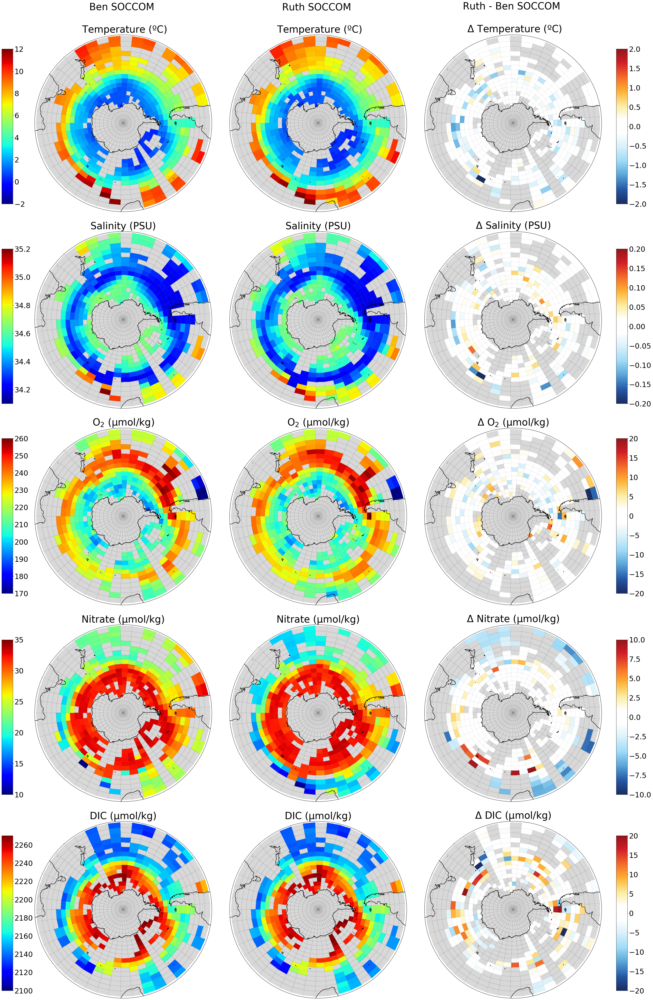

In [281]:
fig = plt.figure(figsize=[42, 74])
gs = gridspec.GridSpec(5,3)
proj = ccrs.Stereographic(central_longitude=-150,central_latitude=-90)
ax, ax1, ax2, ax3, ax4, ax5,ax6,ax7,ax8,ax9, ax10,ax11,ax12,ax13,ax14 = plt.subplot(gs[0,0], projection =proj), plt.subplot(gs[0,1], projection =proj), plt.subplot(gs[0,2], projection =proj),plt.subplot(gs[1,0], projection =proj),plt.subplot(gs[1,1], projection =proj),plt.subplot(gs[1,2], projection =proj),plt.subplot(gs[2,0], projection =proj),plt.subplot(gs[2,1], projection =proj),plt.subplot(gs[2,2], projection =proj),plt.subplot(gs[3,0], projection =proj),plt.subplot(gs[3,1], projection =proj),plt.subplot(gs[3,2], projection =proj),plt.subplot(gs[4,0], projection =proj),plt.subplot(gs[4,1], projection =proj),plt.subplot(gs[4,2], projection =proj)

gs.update(wspace = 0.1, hspace = 0.05)

cmap = pcm.jet
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=12) 
temp = plot_ben_grid(ax, Ben_SOCCOM_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax.set_title('Ben SOCCOM \n \n Temperature (ºC)', fontsize = 40)
plot_ben_grid(ax1, Ruth_SOCCOM_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax1.set_title('Ruth SOCCOM \n \n Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.08, 0.745, 0.015, 0.12])
cbar=plt.colorbar(temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=34.1,vmax=35.2) 
salt = plot_ben_grid(ax3, Ben_SOCCOM_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax3.set_title('Salinity (PSU)', fontsize = 40)
plot_ben_grid(ax4, Ruth_SOCCOM_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax4.set_title('Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.08, 0.59, 0.015, 0.12])
cbar=plt.colorbar(salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=170,vmax=260) 
oxyg = plot_ben_grid(ax6, Ben_SOCCOM_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax6.set_title('O$_2$ (µmol/kg)', fontsize = 40)
plot_ben_grid(ax7, Ruth_SOCCOM_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax7.set_title('O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.443, 0.015, 0.12])
cbar=plt.colorbar(oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=10,vmax=35) 
nitr = plot_ben_grid(ax9, Ben_SOCCOM_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax9.set_title('Nitrate (µmol/kg)', fontsize = 40)
plot_ben_grid(ax10, Ruth_SOCCOM_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax10.set_title('Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.287, 0.015, 0.12])
cbar=plt.colorbar(nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=2100,vmax=2270) 
dic = plot_ben_grid(ax12, Ben_SOCCOM_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax12.set_title('DIC (µmol/kg)', fontsize = 40)
plot_ben_grid(ax13, Ben_SOCCOM_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax13.set_title('DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.135, 0.015, 0.12])
cbar=plt.colorbar(dic,cax = cax,orientation='vertical',shrink = 0.5)

cmap = nclcmaps.cmap('BlueWhiteOrangeRed')
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=2) 
anom_temp = plot_ben_grid(ax2, anomaly_SOCCOM_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax2.set_title('Ruth - Ben SOCCOM \n \n $\Delta$ Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.92, 0.745, 0.015, 0.12])
cbar=plt.colorbar(anom_temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-0.2,vmax=0.2) 
anom_salt = plot_ben_grid(ax5, anomaly_SOCCOM_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax5.set_title('$\Delta$ Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.92, 0.59, 0.015, 0.12])
cbar=plt.colorbar(anom_salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_oxyg = plot_ben_grid(ax8, anomaly_SOCCOM_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax8.set_title('$\Delta$ O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.443, 0.015, 0.12])
cbar=plt.colorbar(anom_oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-10,vmax=10) 
anom_nitr = plot_ben_grid(ax11, anomaly_SOCCOM_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax11.set_title('$\Delta$ Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.287, 0.015, 0.12])
cbar=plt.colorbar(anom_nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_dic = plot_ben_grid(ax14, anomaly_SOCCOM_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax14.set_title('$\Delta$ DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.135, 0.015, 0.12])
cbar=plt.colorbar(anom_dic,cax = cax,orientation='vertical',shrink = 0.5)

figurepath = 'SF2-SOCCOM-comparison.png'
plt.savefig(figurepath, dpi=None, facecolor='w', edgecolor='w',orientation='portrait', papertype=None, format='png',transparent=False, bbox_inches='tight', pad_inches=0.1,frameon=None)


plt.show()

#### add-on: reload and save everything in singular dataset (just to clean up my directories a little)

In [18]:
ds = xr.open_dataset(float_dir+'ALL_FLOATS_TEMPERATURE-climatology-binned-bronselaer.nc')
SOCCOM_temp_linear_climatology= ds.linear
SOCCOM_temp_nearest_climatology= ds.nearest
SOCCOM_temp_cubic_climatology= ds.cubic
SOCCOM_temp_quad_climatology= ds.quad
temp_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_SALINITY-climatology-binned-bronselaer.nc')
SOCCOM_salt_linear_climatology= ds.linear
SOCCOM_salt_nearest_climatology= ds.nearest
SOCCOM_salt_cubic_climatology= ds.cubic
SOCCOM_salt_quad_climatology= ds.quad
salt_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_SIGMA_THETA-climatology-binned-bronselaer.nc')
SOCCOM_sigm_linear_climatology= ds.linear
SOCCOM_sigm_nearest_climatology= ds.nearest
SOCCOM_sigm_cubic_climatology= ds.cubic
SOCCOM_sigm_quad_climatology= ds.quad
sigma_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_OXYGEN-climatology-binned-bronselaer.nc')
SOCCOM_oxyg_linear_climatology= ds.linear
SOCCOM_oxyg_nearest_climatology= ds.nearest
SOCCOM_oxyg_cubic_climatology= ds.cubic
SOCCOM_oxyg_quad_climatology= ds.quad
oxygen_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_NITRATE-climatology-binned-bronselaer.nc')
SOCCOM_nitr_linear_climatology= ds.linear
SOCCOM_nitr_nearest_climatology= ds.nearest
SOCCOM_nitr_cubic_climatology= ds.cubic
SOCCOM_nitr_quad_climatology= ds.quad
nitrate_profile_count= ds.profile_count

ds = xr.open_dataset(float_dir+'ALL_FLOATS_DIC-climatology-binned-bronselaer.nc')
SOCCOM_dic_linear_climatology= ds.linear
SOCCOM_dic_nearest_climatology= ds.nearest
SOCCOM_dic_cubic_climatology= ds.cubic
SOCCOM_dic_quad_climatology= ds.quad
dic_profile_count= ds.profile_count

In [19]:
ds = xr.Dataset({'temp_linear':SOCCOM_temp_linear_climatology, 'temp_nearest': SOCCOM_temp_nearest_climatology, 'temp_cubic':SOCCOM_temp_cubic_climatology, 'temp_quad': SOCCOM_temp_quad_climatology,'salt_linear':SOCCOM_salt_linear_climatology, 'salt_nearest': SOCCOM_salt_nearest_climatology, 'salt_cubic':SOCCOM_salt_cubic_climatology, 'salt_quad': SOCCOM_salt_quad_climatology,'nitrate_linear':SOCCOM_nitr_linear_climatology, 'nitrate_nearest': SOCCOM_nitr_nearest_climatology, 'nitrate_cubic':SOCCOM_nitr_cubic_climatology, 'nitrate_quad': SOCCOM_nitr_quad_climatology,'oxygen_linear':SOCCOM_oxyg_linear_climatology, 'oxygen_nearest': SOCCOM_oxyg_nearest_climatology, 'oxygen_cubic':SOCCOM_oxyg_cubic_climatology, 'oxygen_quad': SOCCOM_oxyg_quad_climatology,'sigma_linear':SOCCOM_sigm_linear_climatology, 'sigma_nearest': SOCCOM_sigm_nearest_climatology, 'sigma_cubic':SOCCOM_sigm_cubic_climatology, 'sigma_quad': SOCCOM_sigm_quad_climatology,'dic_linear':SOCCOM_dic_linear_climatology, 'dic_nearest': SOCCOM_dic_nearest_climatology, 'dic_cubic':SOCCOM_dic_cubic_climatology, 'dic_quad': SOCCOM_dic_quad_climatology, 'temp_profile_count': temp_profile_count, 'salt_profile_count':salt_profile_count,'sigma_profile_count':sigma_profile_count,'oxygen_profile_count':oxygen_profile_count,'nitrate_profile_count':nitrate_profile_count,'dic_profile_count':dic_profile_count})
ds.to_netcdf(float_dir+'SOCCOM_ALL_FLOAT-bronselaer-gridded-climatology.nc')

## Replication of the analysis - GLODAP

The procedure is much the same as what's described sor SOCCOM, with the exception that, at the horizontal gridding step, we do not produce a climatology but simply aggregate all profiles into a single gridded product. Most profiles are collected in the summer, an extensive climatology is not feasible.

### Step 1: vertical interpolating and gridding

In [13]:
filename = '/work/Ruth.Moorman/GLODAP/GLODAPv2.2019_Southern_Ocean_30S.nc'
so_glodap = xr.open_dataset(filename)
so_glodap = so_glodap.Southern_Ocean_GLODAP

In [14]:
# need a unique identifier to flag the start of each unique profile/cast
cruise = so_glodap.cruise.values
station = so_glodap.station.values
time = so_glodap.station.time.astype('float').values
profile_identifier = np.stack((cruise, station, time))
profile_index = np.unique(profile_identifier, axis = 1, return_index = True)[1]
print('Number of GLODAP profiles in the Southern Ocean south of 30S (all time):',len(profile_index))

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765


In [15]:
profile_index = np.sort(profile_index)

The rest was completed using the following function.

In [16]:
help(interpolate_GLODAP_profiles)

Help on function interpolate_GLODAP_profiles in module SOCCOM_GLODAP_processing:

interpolate_GLODAP_profiles(variable)
    Aggregates all GLODAP profile data from GLODAPv2.2019_Southern_Ocean_30S.nc into a single xarray datastructure with dimensions N_PROF and depth.
    depth_bin dimension is determined interpolating SOCCOM float data onto a 2001 level 1m grid [0,1,...,2000] using 4 interpolation methods: linear, nearest neighbour, cubic spline and quadratic spline (so later uncertainty associated with the interpolation method may be quantified)
    
    variable is a string that is set to one of the following:
    
    Temperature
    Salinity
    Sigma_theta
    Oxygen
    Nitrate
    DIC
    
    will return 4 DataArray structures associated with the 4 interpolation methods.
    return tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic
    
    Ruth Moorman, Princeton University, Mar 2020



The above was run for all variables, below we reload and continue.

In [17]:
float_dir = '/work/Ruth.Moorman/GLODAP/processed_GLODAP/'

In [19]:
%%time
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolate_GLODAP_profiles('Temperature')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All profiles Temp interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_PROFILES_TEMPERATURE-vertically-interpolated-preQC.nc')

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765
dropped 34540 profiles (too few data for spline interpolation, <3 points)
retained 9225 profiles
CPU times: user 14min 50s, sys: 4.23 s, total: 14min 54s
Wall time: 14min 55s


In [20]:
%%time
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolate_GLODAP_profiles('Salinity')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All profiles Salinity interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_PROFILES_SALINITY-vertically-interpolated-preQC.nc')

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765
dropped 34436 profiles (too few data for spline interpolation, <3 points)
retained 9329 profiles
CPU times: user 14min 47s, sys: 4.07 s, total: 14min 51s
Wall time: 14min 52s


In [21]:
%%time
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolate_GLODAP_profiles('Sigma_theta')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All profiles Sigma0 interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_PROFILES_SIGMA-vertically-interpolated-preQC.nc')

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765
dropped 34554 profiles (too few data for spline interpolation, <3 points)
retained 9211 profiles
CPU times: user 14min 40s, sys: 4.17 s, total: 14min 44s
Wall time: 14min 45s


In [22]:
%%time
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolate_GLODAP_profiles('Oxygen')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All profiles Oxygen interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_PROFILES_OXYGEN-vertically-interpolated-preQC.nc')

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765
dropped 35092 profiles (too few data for spline interpolation, <3 points)
retained 8673 profiles
CPU times: user 14min 23s, sys: 4.55 s, total: 14min 27s
Wall time: 14min 28s


In [23]:
%%time
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolate_GLODAP_profiles('Nitrate')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All profiles Nitrate interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_PROFILES_NITRATE-vertically-interpolated-preQC.nc')

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765
dropped 35816 profiles (too few data for spline interpolation, <3 points)
retained 7949 profiles
CPU times: user 14min 4s, sys: 4.16 s, total: 14min 8s
Wall time: 14min 10s


In [24]:
%%time
tracer_linear, tracer_nearest_neighbour, tracer_cubic, tracer_quadratic = interpolate_GLODAP_profiles('DIC')
ds = xr.Dataset({'linear':tracer_linear, 'nearest': tracer_nearest_neighbour, 'cubic':tracer_cubic, 'quad': tracer_quadratic})
ds.attrs['description'] = 'All profiles DIC interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods'
ds.to_netcdf(float_dir+'ALL_PROFILES_DIC-vertically-interpolated-preQC.nc')

Number of GLODAP profiles in the Southern Ocean south of 30S (all time): 43765
dropped 39387 profiles (too few data for spline interpolation, <3 points)
retained 4378 profiles
CPU times: user 12min 25s, sys: 4.81 s, total: 12min 30s
Wall time: 12min 30s


In [25]:
ds = xr.open_dataset(float_dir+'ALL_PROFILES_TEMPERATURE-vertically-interpolated-preQC.nc')
temp_linear= ds.linear
temp_nearest= ds.nearest
temp_cubic= ds.cubic
temp_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_SALINITY-vertically-interpolated-preQC.nc')
salt_linear= ds.linear
salt_nearest= ds.nearest
salt_cubic= ds.cubic
salt_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_SIGMA-vertically-interpolated-preQC.nc')
sigma_linear= ds.linear
sigma_nearest= ds.nearest
sigma_cubic= ds.cubic
sigma_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_OXYGEN-vertically-interpolated-preQC.nc')
oxygen_linear= ds.linear
oxygen_nearest= ds.nearest
oxygen_cubic= ds.cubic
oxygen_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_NITRATE-vertically-interpolated-preQC.nc')
nitrate_linear= ds.linear
nitrate_nearest= ds.nearest
nitrate_cubic= ds.cubic
nitrate_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_DIC-vertically-interpolated-preQC.nc')
dic_linear= ds.linear
dic_nearest= ds.nearest
dic_cubic= ds.cubic
dic_quad= ds.quad

In [26]:
threshold = 1
cubic_error_indices = temp_cubic.where(np.abs(temp_cubic-temp_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = temp_quad.where(np.abs(temp_quad-temp_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
temp_linear[interp_error_profiles,:] = np.nan
temp_cubic[interp_error_profiles,:] = np.nan
temp_quad[interp_error_profiles,:] = np.nan
temp_nearest[interp_error_profiles,:] = np.nan
temp_linear = temp_linear.where(np.abs(temp_linear)>0,drop = True)
temp_cubic = temp_cubic.where(np.abs(temp_cubic)>0,drop = True)
temp_quad = temp_quad.where(np.abs(temp_quad)>0,drop = True)
temp_nearest = temp_nearest.where(np.abs(temp_nearest)>0,drop = True)
print('Retain %i profiles'%len(temp_linear.N_PROF))
ds = xr.Dataset({'linear':temp_linear, 'nearest': temp_nearest, 'cubic':temp_cubic, 'quad': temp_quad})
ds.attrs['description'] = 'All profiles Temp interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolation removed)'
ds.to_netcdf(float_dir+'ALL_PROFILES_TEMPERATURE-vertically-interpolated-QC.nc')

Drop 739 profiles
Retain 8455 profiles


In [27]:
threshold = 0.15
cubic_error_indices = salt_cubic.where(np.abs(salt_cubic-salt_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = salt_quad.where(np.abs(salt_quad-salt_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
salt_linear[interp_error_profiles,:] = np.nan
salt_cubic[interp_error_profiles,:] = np.nan
salt_quad[interp_error_profiles,:] = np.nan
salt_nearest[interp_error_profiles,:] = np.nan
salt_linear = salt_linear.where(np.abs(salt_linear)>0,drop = True)
salt_cubic = salt_cubic.where(np.abs(salt_cubic)>0,drop = True)
salt_quad = salt_quad.where(np.abs(salt_quad)>0,drop = True)
salt_nearest = salt_nearest.where(np.abs(salt_nearest)>0,drop = True)
print('Retain %i profiles'%len(salt_linear.N_PROF))
ds = xr.Dataset({'linear':salt_linear, 'nearest': salt_nearest, 'cubic':salt_cubic, 'quad': salt_quad})
ds.attrs['description'] = 'All profiles Salinity interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_PROFILES_SALINITY-vertically-interpolated-QC.nc')

Drop 960 profiles
Retain 8338 profiles


In [28]:
threshold = 15
cubic_error_indices = oxygen_cubic.where(np.abs(oxygen_cubic-oxygen_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = oxygen_quad.where(np.abs(oxygen_quad-oxygen_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
oxygen_linear[interp_error_profiles,:] = np.nan
oxygen_cubic[interp_error_profiles,:] = np.nan
oxygen_quad[interp_error_profiles,:] = np.nan
oxygen_nearest[interp_error_profiles,:] = np.nan
oxygen_linear = oxygen_linear.where(np.abs(oxygen_linear)>0,drop = True)
oxygen_cubic = oxygen_cubic.where(np.abs(oxygen_cubic)>0,drop = True)
oxygen_quad = oxygen_quad.where(np.abs(oxygen_quad)>0,drop = True)
oxygen_nearest = oxygen_nearest.where(np.abs(oxygen_nearest)>0,drop = True)
print('Retain %i profiles'%len(oxygen_linear.N_PROF))
ds = xr.Dataset({'linear':oxygen_linear, 'nearest': oxygen_nearest, 'cubic':oxygen_cubic, 'quad': oxygen_quad})
ds.attrs['description'] = 'All profiles Oxygen interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneos interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_PROFILES_OXYGEN-vertically-interpolated-QC.nc')

Drop 1723 profiles
Retain 6927 profiles


In [29]:
threshold = 0.3
cubic_error_indices = sigma_cubic.where(np.abs(sigma_cubic-sigma_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = sigma_quad.where(np.abs(sigma_quad-sigma_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
sigma_linear[interp_error_profiles,:] = np.nan
sigma_cubic[interp_error_profiles,:] = np.nan
sigma_quad[interp_error_profiles,:] = np.nan
sigma_nearest[interp_error_profiles,:] = np.nan
sigma_linear = sigma_linear.where(np.abs(sigma_linear)>0,drop = True)
sigma_cubic = sigma_cubic.where(np.abs(sigma_cubic)>0,drop = True)
sigma_quad = sigma_quad.where(np.abs(sigma_quad)>0,drop = True)
sigma_nearest = sigma_nearest.where(np.abs(sigma_nearest)>0,drop = True)
print('Retain %i profiles'%len(sigma_linear.N_PROF))
ds = xr.Dataset({'linear':sigma_linear, 'nearest': sigma_nearest, 'cubic':sigma_cubic, 'quad': sigma_quad})
ds.attrs['description'] = 'All profiles Sigma interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_PROFILES_SIGMA-vertically-interpolated-QC.nc')

Drop 416 profiles
Retain 8764 profiles


In [30]:
threshold = 2
cubic_error_indices = nitrate_cubic.where(np.abs(nitrate_cubic-nitrate_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = nitrate_quad.where(np.abs(nitrate_quad-nitrate_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
nitrate_linear[interp_error_profiles,:] = np.nan
nitrate_cubic[interp_error_profiles,:] = np.nan
nitrate_quad[interp_error_profiles,:] = np.nan
nitrate_nearest[interp_error_profiles,:] = np.nan
nitrate_linear = nitrate_linear.where(nitrate_linear>0,drop = True)
nitrate_cubic = nitrate_cubic.where(nitrate_cubic>0,drop = True)
nitrate_quad = nitrate_quad.where(nitrate_quad>0,drop = True)
nitrate_nearest = nitrate_nearest.where(nitrate_nearest>0,drop = True)
print('Retain %i profiles'%len(nitrate_linear.N_PROF))
ds = xr.Dataset({'linear':nitrate_linear, 'nearest': nitrate_nearest, 'cubic':nitrate_cubic, 'quad': nitrate_quad})
ds.attrs['description'] = 'All float Nitrate interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_PROFILES_NITRATE-vertically-interpolated-QC.nc')

Drop 899 profiles
Retain 7035 profiles


In [31]:
threshold = 10
cubic_error_indices = dic_cubic.where(np.abs(dic_cubic-dic_linear)>threshold, drop=True).N_PROF.values
quad_error_indices = dic_quad.where(np.abs(dic_quad-dic_linear)>threshold, drop=True).N_PROF.values
interp_error_profiles = np.unique(np.append(quad_error_indices, cubic_error_indices))
print('Drop %i profiles'%len(interp_error_profiles))
dic_linear[interp_error_profiles,:] = np.nan
dic_cubic[interp_error_profiles,:] = np.nan
dic_quad[interp_error_profiles,:] = np.nan
dic_nearest[interp_error_profiles,:] = np.nan
dic_linear = dic_linear.where(dic_linear>0,drop = True)
dic_cubic = dic_cubic.where(dic_cubic>0,drop = True)
dic_quad = dic_quad.where(dic_quad>0,drop = True)
dic_nearest = dic_nearest.where(dic_nearest>0,drop = True)
print('Retain %i profiles'%len(dic_linear.N_PROF))

ds = xr.Dataset({'linear':dic_linear, 'nearest': dic_nearest, 'cubic':dic_cubic, 'quad': dic_quad})
ds.attrs['description'] = 'All profiles DIC interpolated onto a 1m vertical grid using linear, nearest neighbour, cublic spline and quadratic spline interpolation methods (erroneous interpolations dropped)'
ds.to_netcdf(float_dir+'ALL_PROFILES_DIC-vertically-interpolated-QC.nc')

Drop 1070 profiles
Retain 3302 profiles


### Step 2: vertical binning and time slicing

In [32]:
def depth_binned_profiles_Bronselaer_GLODAP(file):
    """
    Depth averages interpolated GLODAP profiles into bins used by Ben Bronselaer in 2020 nature geoscience paper.
    Provide file name.
    Will mask for floats collected between 1985 and 2005 (inclusive).
    return SGLODAPlinear_depth_binned, GLODAP_nearest_depth_binned, GLODAP_cubic_depth_binned, GLODAP_quad_depth_binned
    Ruth Moorman, Princeton University, Mar 2020
    """
    glodap = xr.open_dataset(file)
    # time slice as Ben
    glodap = glodap.where(glodap.time >= np.datetime64('1985'), drop = True).where(glodap.time < np.datetime64('2006'), drop = True)

    GLODAP_linear = glodap.linear
    GLODAP_nearest = glodap.nearest
    GLODAP_cubic = glodap.cubic
    GLODAP_quad = glodap.quad
    depth_bin_center = np.array([4.,7.,12.,19.,26.,35.,47.,65.,91.,126.,179.,249.,346.,468.,614.,772.,947.,1123.,1298.,1474.,1649.,1825.,2000.])
    depth_bin_bounds = np.array([2.5,5.5,8.5,15.5,22.5,29.5,40.5,53.5,76.5,105.5,146.5,211.5,286.5,405.5,530.5,697.5,846.5,1047.5,1198.5,1397.5,1550.5,1747.5,1902.5,2097.5,])

    ## groupby depth bins and mean
    GLODAP_linear_depth_binned = GLODAP_linear.groupby_bins('depth', depth_bin_bounds).mean()
    GLODAP_nearest_depth_binned = GLODAP_nearest.groupby_bins('depth', depth_bin_bounds).mean()
    GLODAP_cubic_depth_binned = GLODAP_cubic.groupby_bins('depth', depth_bin_bounds).mean()
    GLODAP_quad_depth_binned = GLODAP_quad.groupby_bins('depth', depth_bin_bounds).mean()

    ## replace depth bin tuple coordinate with bin center values (but retain bin bounds as a separate dimension)
    GLODAP_linear_depth_binned.coords['depth_bin_bounds'] = GLODAP_linear_depth_binned.depth_bins
    GLODAP_nearest_depth_binned.coords['depth_bin_bounds'] = GLODAP_nearest_depth_binned.depth_bins
    GLODAP_cubic_depth_binned.coords['depth_bin_bounds'] = GLODAP_cubic_depth_binned.depth_bins
    GLODAP_quad_depth_binned.coords['depth_bin_bounds'] = GLODAP_quad_depth_binned.depth_bins
    GLODAP_linear_depth_binned.coords['depth_bins'] = depth_bin_center
    GLODAP_nearest_depth_binned.coords['depth_bins'] = depth_bin_center
    GLODAP_cubic_depth_binned.coords['depth_bins'] = depth_bin_center
    GLODAP_quad_depth_binned.coords['depth_bins'] = depth_bin_center
    
    return GLODAP_linear_depth_binned, GLODAP_nearest_depth_binned, GLODAP_cubic_depth_binned, GLODAP_quad_depth_binned


In [33]:
temp_linear_depth_binned, temp_nearest_depth_binned, temp_cubic_depth_binned, temp_quad_depth_binned = depth_binned_profiles_Bronselaer_GLODAP(float_dir+'ALL_PROFILES_TEMPERATURE-vertically-interpolated-QC.nc')
salt_linear_depth_binned, salt_nearest_depth_binned, salt_cubic_depth_binned, salt_quad_depth_binned = depth_binned_profiles_Bronselaer_GLODAP(float_dir+'ALL_PROFILES_SALINITY-vertically-interpolated-QC.nc')
sigm_linear_depth_binned, sigm_nearest_depth_binned, sigm_cubic_depth_binned, sigm_quad_depth_binned = depth_binned_profiles_Bronselaer_GLODAP(float_dir+'ALL_PROFILES_SIGMA-vertically-interpolated-QC.nc')
oxyg_linear_depth_binned, oxyg_nearest_depth_binned, oxyg_cubic_depth_binned, oxyg_quad_depth_binned = depth_binned_profiles_Bronselaer_GLODAP(float_dir+'ALL_PROFILES_OXYGEN-vertically-interpolated-QC.nc')
nitr_linear_depth_binned, nitr_nearest_depth_binned, nitr_cubic_depth_binned, nitr_quad_depth_binned = depth_binned_profiles_Bronselaer_GLODAP(float_dir+'ALL_PROFILES_NITRATE-vertically-interpolated-QC.nc')
dic_linear_depth_binned, dic_nearest_depth_binned, dic_cubic_depth_binned, dic_quad_depth_binned = depth_binned_profiles_Bronselaer_GLODAP(float_dir+'ALL_PROFILES_DIC-vertically-interpolated-QC.nc')

In [34]:
print('Profiles in the chosen time period abiding all QC constraints:')
print('temp:%i'%len(temp_linear_depth_binned.N_PROF))
print('salt:%i'%len(salt_linear_depth_binned.N_PROF))
print('sigm:%i'%len(sigm_linear_depth_binned.N_PROF))
print('oxyg:%i'%len(oxyg_linear_depth_binned.N_PROF))
print('nitr:%i'%len(nitr_linear_depth_binned.N_PROF))
print('dic:%i'%len(dic_linear_depth_binned.N_PROF))


Profiles in the chosen time period abiding all QC constraints:
temp:5689
salt:5679
sigm:5875
oxyg:4655
nitr:4849
dic:2014


### Step 3: binning and averaging onto horizontal grid

In [35]:
help(GLODAP_horizontal_binning_Bronselaer)

Help on function GLODAP_horizontal_binning_Bronselaer in module SOCCOM_GLODAP_processing:

GLODAP_horizontal_binning_Bronselaer(GLODAP_linear_depth_binned, GLODAP_nearest_depth_binned, GLODAP_cubic_depth_binned, GLODAP_quad_depth_binned)
    Creates a gridded product (as per Bronselaer et al 2020) of mean tracer values from a depth 
    binned profile product (linear, nearest, cubic and quadratic interpolation).
    Product will be summer biased.
    return a dataset (ds) of all computed outputs (includes metadata)
    Ruth Moorman, Princeton University, Mar 2020



In [36]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(temp_linear_depth_binned, temp_nearest_depth_binned, temp_cubic_depth_binned, temp_quad_depth_binned)
ds.attrs['description'] = 'All interpolated profile Temp vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'ALL_PROFILES_TEMPERATURE-climatology-binned-bronselaer.nc')

CPU times: user 1min 3s, sys: 21 ms, total: 1min 3s
Wall time: 1min 3s


In [37]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(salt_linear_depth_binned, salt_nearest_depth_binned, salt_cubic_depth_binned, salt_quad_depth_binned)
ds.attrs['description'] = 'All interpolated profile Salt vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'ALL_PROFILES_SALINITY-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 13 ms, total: 1min 1s
Wall time: 1min 1s


In [38]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(sigm_linear_depth_binned, sigm_nearest_depth_binned, sigm_cubic_depth_binned, sigm_quad_depth_binned)
ds.attrs['description'] = 'All interpolated profile Sigma0 vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'ALL_PROFILES_SIGMA-climatology-binned-bronselaer.nc')

CPU times: user 59.8 s, sys: 4 ms, total: 59.8 s
Wall time: 59.9 s


In [39]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(oxyg_linear_depth_binned, oxyg_nearest_depth_binned, oxyg_cubic_depth_binned, oxyg_quad_depth_binned)
ds.attrs['description'] = 'All interpolated profile Oxygen vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'ALL_PROFILES_OXYGEN-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 4 ms, total: 1min 1s
Wall time: 1min 1s


In [40]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(nitr_linear_depth_binned, nitr_nearest_depth_binned, nitr_cubic_depth_binned, nitr_quad_depth_binned)
ds.attrs['description'] = 'All interpolated profile Nitrate vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'ALL_PROFILES_NITRATE-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 14 ms, total: 1min 1s
Wall time: 1min 1s


In [41]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(dic_linear_depth_binned, dic_nearest_depth_binned, dic_cubic_depth_binned, dic_quad_depth_binned)
ds.attrs['description'] = 'All interpolated profile DIC vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'ALL_PROFILES_DIC-climatology-binned-bronselaer.nc')

CPU times: user 57.8 s, sys: 5 ms, total: 57.8 s
Wall time: 57.8 s


In [42]:
ds = xr.open_dataset(float_dir+'ALL_PROFILES_TEMPERATURE-climatology-binned-bronselaer.nc')
GLODAP_temp_linear= ds.linear
GLODAP_temp_nearest= ds.nearest
GLODAP_temp_cubic= ds.cubic
GLODAP_temp_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_SALINITY-climatology-binned-bronselaer.nc')
GLODAP_salt_linear= ds.linear
GLODAP_salt_nearest= ds.nearest
GLODAP_salt_cubic= ds.cubic
GLODAP_salt_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_SIGMA-climatology-binned-bronselaer.nc')
GLODAP_sigm_linear= ds.linear
GLODAP_sigm_nearest= ds.nearest
GLODAP_sigm_cubic= ds.cubic
GLODAP_sigm_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_OXYGEN-climatology-binned-bronselaer.nc')
GLODAP_oxyg_linear= ds.linear
GLODAP_oxyg_nearest= ds.nearest
GLODAP_oxyg_cubic= ds.cubic
GLODAP_oxyg_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_NITRATE-climatology-binned-bronselaer.nc')
GLODAP_nitr_linear= ds.linear
GLODAP_nitr_nearest= ds.nearest
GLODAP_nitr_cubic= ds.cubic
GLODAP_nitr_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_DIC-climatology-binned-bronselaer.nc')
GLODAP_dic_linear= ds.linear
GLODAP_dic_nearest= ds.nearest
GLODAP_dic_cubic= ds.cubic
GLODAP_dic_quad= ds.quad

In [43]:
GLODAP_temp = (GLODAP_temp_linear+GLODAP_temp_nearest+GLODAP_temp_cubic+GLODAP_temp_quad)/4
GLODAP_salt = (GLODAP_salt_linear+GLODAP_salt_nearest+GLODAP_salt_cubic+GLODAP_salt_quad)/4
GLODAP_oxyg = (GLODAP_oxyg_linear+GLODAP_oxyg_nearest+GLODAP_oxyg_cubic+GLODAP_oxyg_quad)/4
GLODAP_nitr = (GLODAP_nitr_linear+GLODAP_nitr_nearest+GLODAP_nitr_cubic+GLODAP_nitr_quad)/4
GLODAP_dic = (GLODAP_dic_linear+GLODAP_dic_nearest+GLODAP_dic_cubic+GLODAP_dic_quad)/4

Ruth_GLODAP_Temp_1000m = upper_1000m_depthmean(GLODAP_temp, dzt)
Ruth_GLODAP_Salt_1000m = upper_1000m_depthmean(GLODAP_salt, dzt)
Ruth_GLODAP_Oxygen_1000m = upper_1000m_depthmean(GLODAP_oxyg, dzt)
Ruth_GLODAP_Nitrate_1000m = upper_1000m_depthmean(GLODAP_nitr, dzt)
Ruth_GLODAP_DIC_1000m = upper_1000m_depthmean(GLODAP_dic, dzt)

In [44]:
Ben_GLODAP_Temp_1000m = xr.concat([Ben_GLODAP_Temp_1000m,extention], dim='longitude')
Ben_GLODAP_Salt_1000m = xr.concat([Ben_GLODAP_Salt_1000m,extention], dim='longitude')
Ben_GLODAP_Oxygen_1000m = xr.concat([Ben_GLODAP_Oxygen_1000m,extention], dim='longitude')
Ben_GLODAP_Nitrate_1000m = xr.concat([Ben_GLODAP_Nitrate_1000m,extention], dim='longitude')
Ben_GLODAP_DIC_1000m = xr.concat([Ben_GLODAP_DIC_1000m,extention], dim='longitude')

In [45]:
anomaly_GLODAP_Temp_1000m = Ruth_GLODAP_Temp_1000m - Ben_GLODAP_Temp_1000m
anomaly_GLODAP_Salt_1000m = Ruth_GLODAP_Salt_1000m - Ben_GLODAP_Salt_1000m
anomaly_GLODAP_Nitrate_1000m = Ruth_GLODAP_Nitrate_1000m - Ben_GLODAP_Nitrate_1000m
anomaly_GLODAP_DIC_1000m = Ruth_GLODAP_DIC_1000m - Ben_GLODAP_DIC_1000m
anomaly_GLODAP_Oxygen_1000m = Ruth_GLODAP_Oxygen_1000m - Ben_GLODAP_Oxygen_1000m

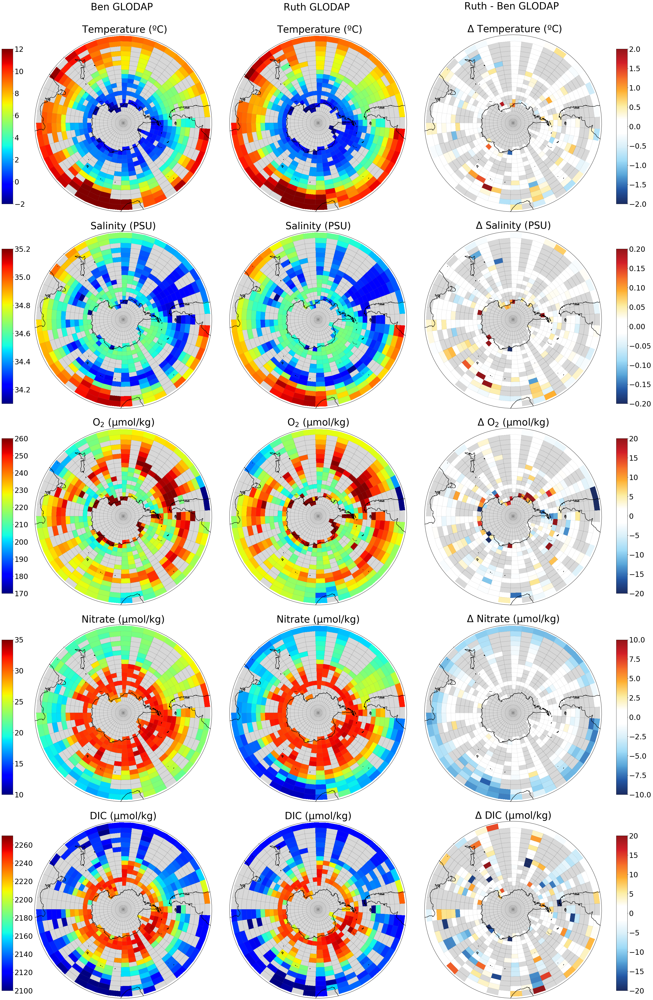

In [46]:
fig = plt.figure(figsize=[42, 74])
gs = gridspec.GridSpec(5,3)
proj = ccrs.Stereographic(central_longitude=-150,central_latitude=-90)
ax, ax1, ax2, ax3, ax4, ax5,ax6,ax7,ax8,ax9, ax10,ax11,ax12,ax13,ax14 = plt.subplot(gs[0,0], projection =proj), plt.subplot(gs[0,1], projection =proj), plt.subplot(gs[0,2], projection =proj),plt.subplot(gs[1,0], projection =proj),plt.subplot(gs[1,1], projection =proj),plt.subplot(gs[1,2], projection =proj),plt.subplot(gs[2,0], projection =proj),plt.subplot(gs[2,1], projection =proj),plt.subplot(gs[2,2], projection =proj),plt.subplot(gs[3,0], projection =proj),plt.subplot(gs[3,1], projection =proj),plt.subplot(gs[3,2], projection =proj),plt.subplot(gs[4,0], projection =proj),plt.subplot(gs[4,1], projection =proj),plt.subplot(gs[4,2], projection =proj)

gs.update(wspace = 0.1, hspace = 0.05)

cmap = pcm.jet
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=12) 
temp = plot_ben_grid(ax, Ben_GLODAP_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax.set_title('Ben GLODAP \n \n Temperature (ºC)', fontsize = 40)
plot_ben_grid(ax1, Ruth_GLODAP_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax1.set_title('Ruth GLODAP \n \n Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.08, 0.745, 0.015, 0.12])
cbar=plt.colorbar(temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=34.1,vmax=35.2) 
salt = plot_ben_grid(ax3, Ben_GLODAP_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax3.set_title('Salinity (PSU)', fontsize = 40)
plot_ben_grid(ax4, Ruth_GLODAP_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax4.set_title('Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.08, 0.59, 0.015, 0.12])
cbar=plt.colorbar(salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=170,vmax=260) 
oxyg = plot_ben_grid(ax6, Ben_GLODAP_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax6.set_title('O$_2$ (µmol/kg)', fontsize = 40)
plot_ben_grid(ax7, Ruth_GLODAP_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax7.set_title('O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.443, 0.015, 0.12])
cbar=plt.colorbar(oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=10,vmax=35) 
nitr = plot_ben_grid(ax9, Ben_GLODAP_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax9.set_title('Nitrate (µmol/kg)', fontsize = 40)
plot_ben_grid(ax10, Ruth_GLODAP_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax10.set_title('Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.287, 0.015, 0.12])
cbar=plt.colorbar(nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=2100,vmax=2270) 
dic = plot_ben_grid(ax12, Ben_GLODAP_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax12.set_title('DIC (µmol/kg)', fontsize = 40)
plot_ben_grid(ax13, Ruth_GLODAP_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax13.set_title('DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.135, 0.015, 0.12])
cbar=plt.colorbar(dic,cax = cax,orientation='vertical',shrink = 0.5)

cmap = nclcmaps.cmap('BlueWhiteOrangeRed')
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=2) 
anom_temp = plot_ben_grid(ax2, anomaly_GLODAP_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax2.set_title('Ruth - Ben GLODAP \n \n $\Delta$ Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.92, 0.745, 0.015, 0.12])
cbar=plt.colorbar(anom_temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-0.2,vmax=0.2) 
anom_salt = plot_ben_grid(ax5, anomaly_GLODAP_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax5.set_title('$\Delta$ Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.92, 0.59, 0.015, 0.12])
cbar=plt.colorbar(anom_salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_oxyg = plot_ben_grid(ax8, anomaly_GLODAP_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax8.set_title('$\Delta$ O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.443, 0.015, 0.12])
cbar=plt.colorbar(anom_oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-10,vmax=10) 
anom_nitr = plot_ben_grid(ax11, anomaly_GLODAP_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax11.set_title('$\Delta$ Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.287, 0.015, 0.12])
cbar=plt.colorbar(anom_nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_dic = plot_ben_grid(ax14, anomaly_GLODAP_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax14.set_title('$\Delta$ DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.135, 0.015, 0.12])
cbar=plt.colorbar(anom_dic,cax = cax,orientation='vertical',shrink = 0.5)

figurepath = 'SF2-GLODAP-comparison.png'
plt.savefig(figurepath, dpi=None, facecolor='w', edgecolor='w',orientation='portrait', papertype=None, format='png',transparent=False, bbox_inches='tight', pad_inches=0.1,frameon=None)


plt.show()

#### add-on: reload and save as one dataset

In [47]:
ds = xr.open_dataset(float_dir+'ALL_PROFILES_TEMPERATURE-climatology-binned-bronselaer.nc')
GLODAP_temp_linear= ds.linear
GLODAP_temp_nearest= ds.nearest
GLODAP_temp_cubic= ds.cubic
GLODAP_temp_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_SALINITY-climatology-binned-bronselaer.nc')
GLODAP_salt_linear= ds.linear
GLODAP_salt_nearest= ds.nearest
GLODAP_salt_cubic= ds.cubic
GLODAP_salt_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_SIGMA-climatology-binned-bronselaer.nc')
GLODAP_sigm_linear= ds.linear
GLODAP_sigm_nearest= ds.nearest
GLODAP_sigm_cubic= ds.cubic
GLODAP_sigm_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_OXYGEN-climatology-binned-bronselaer.nc')
GLODAP_oxyg_linear= ds.linear
GLODAP_oxyg_nearest= ds.nearest
GLODAP_oxyg_cubic= ds.cubic
GLODAP_oxyg_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_NITRATE-climatology-binned-bronselaer.nc')
GLODAP_nitr_linear= ds.linear
GLODAP_nitr_nearest= ds.nearest
GLODAP_nitr_cubic= ds.cubic
GLODAP_nitr_quad= ds.quad

ds = xr.open_dataset(float_dir+'ALL_PROFILES_DIC-climatology-binned-bronselaer.nc')
GLODAP_dic_linear= ds.linear
GLODAP_dic_nearest= ds.nearest
GLODAP_dic_cubic= ds.cubic
GLODAP_dic_quad= ds.quad

In [48]:
ds = xr.Dataset({'temp_linear':GLODAP_temp_linear, 'temp_nearest': GLODAP_temp_nearest, 'temp_cubic':GLODAP_temp_cubic, 'temp_quad': GLODAP_temp_quad,'salt_linear':GLODAP_salt_linear, 'salt_nearest': GLODAP_salt_nearest, 'salt_cubic':GLODAP_salt_cubic, 'salt_quad': GLODAP_salt_quad,'nitrate_linear':GLODAP_nitr_linear, 'nitrate_nearest': GLODAP_nitr_nearest, 'nitrate_cubic':GLODAP_nitr_cubic, 'nitrate_quad': GLODAP_nitr_quad,'oxygen_linear':GLODAP_oxyg_linear, 'oxygen_nearest': GLODAP_oxyg_nearest, 'oxygen_cubic':GLODAP_oxyg_cubic, 'oxygen_quad': GLODAP_oxyg_quad,'sigma_linear':GLODAP_sigm_linear, 'sigma_nearest': GLODAP_sigm_nearest, 'sigma_cubic':GLODAP_sigm_cubic, 'sigma_quad': GLODAP_sigm_quad,'dic_linear':GLODAP_dic_linear, 'dic_nearest': GLODAP_dic_nearest, 'dic_cubic':GLODAP_dic_cubic, 'dic_quad': GLODAP_dic_quad})
ds.to_netcdf(float_dir+'GLODAP-bronselaer-gridded-climatology.nc')

## Modification of the analysis - GLODAP bathymetry masking

Changes start at the stage of vertically and horizontally binning.

In [49]:
### modification: mask out profiles where bottom bathymetry < 2000 m

In [50]:
def depth_binned_profiles_bathy_GLODAP(file):
    """
    Depth averages interpolated GLODAP profiles into bins used by Ben Bronselaer in 2020 nature geoscience paper.
    Provide file name.
    Will mask for profiles collected between 1985 and 2005 (inclusive).
    Will mask for profiles collected where the bathymetry is deeper than 2000m.
    return SGLODAPlinear_depth_binned, GLODAP_nearest_depth_binned, GLODAP_cubic_depth_binned, GLODAP_quad_depth_binned
    Ruth Moorman, Princeton University, Mar 2020
    """
    glodap = xr.open_dataset(file)
    # time slice as Ben
    glodap = glodap.where(glodap.time >= np.datetime64('1985'), drop = True).where(glodap.time < np.datetime64('2006'), drop = True)
    # bathymetry mask
    glodap = glodap.where(glodap.bottomdepth>2000,drop = True)

    GLODAP_linear = glodap.linear
    GLODAP_nearest = glodap.nearest
    GLODAP_cubic = glodap.cubic
    GLODAP_quad = glodap.quad
    depth_bin_center = np.array([4.,7.,12.,19.,26.,35.,47.,65.,91.,126.,179.,249.,346.,468.,614.,772.,947.,1123.,1298.,1474.,1649.,1825.,2000.])
    depth_bin_bounds = np.array([2.5,5.5,8.5,15.5,22.5,29.5,40.5,53.5,76.5,105.5,146.5,211.5,286.5,405.5,530.5,697.5,846.5,1047.5,1198.5,1397.5,1550.5,1747.5,1902.5,2097.5,])

    ## groupby depth bins and mean
    GLODAP_linear_depth_binned = GLODAP_linear.groupby_bins('depth', depth_bin_bounds).mean()
    GLODAP_nearest_depth_binned = GLODAP_nearest.groupby_bins('depth', depth_bin_bounds).mean()
    GLODAP_cubic_depth_binned = GLODAP_cubic.groupby_bins('depth', depth_bin_bounds).mean()
    GLODAP_quad_depth_binned = GLODAP_quad.groupby_bins('depth', depth_bin_bounds).mean()

    ## replace depth bin tuple coordinate with bin center values (but retain bin bounds as a separate dimension)
    GLODAP_linear_depth_binned.coords['depth_bin_bounds'] = GLODAP_linear_depth_binned.depth_bins
    GLODAP_nearest_depth_binned.coords['depth_bin_bounds'] = GLODAP_nearest_depth_binned.depth_bins
    GLODAP_cubic_depth_binned.coords['depth_bin_bounds'] = GLODAP_cubic_depth_binned.depth_bins
    GLODAP_quad_depth_binned.coords['depth_bin_bounds'] = GLODAP_quad_depth_binned.depth_bins
    GLODAP_linear_depth_binned.coords['depth_bins'] = depth_bin_center
    GLODAP_nearest_depth_binned.coords['depth_bins'] = depth_bin_center
    GLODAP_cubic_depth_binned.coords['depth_bins'] = depth_bin_center
    GLODAP_quad_depth_binned.coords['depth_bins'] = depth_bin_center
    
    return GLODAP_linear_depth_binned, GLODAP_nearest_depth_binned, GLODAP_cubic_depth_binned, GLODAP_quad_depth_binned


In [51]:
temp_linear_depth_binned, temp_nearest_depth_binned, temp_cubic_depth_binned, temp_quad_depth_binned = depth_binned_profiles_bathy_GLODAP(float_dir+'ALL_PROFILES_TEMPERATURE-vertically-interpolated-QC.nc')
salt_linear_depth_binned, salt_nearest_depth_binned, salt_cubic_depth_binned, salt_quad_depth_binned = depth_binned_profiles_bathy_GLODAP(float_dir+'ALL_PROFILES_SALINITY-vertically-interpolated-QC.nc')
sigm_linear_depth_binned, sigm_nearest_depth_binned, sigm_cubic_depth_binned, sigm_quad_depth_binned = depth_binned_profiles_bathy_GLODAP(float_dir+'ALL_PROFILES_SIGMA-vertically-interpolated-QC.nc')
oxyg_linear_depth_binned, oxyg_nearest_depth_binned, oxyg_cubic_depth_binned, oxyg_quad_depth_binned = depth_binned_profiles_bathy_GLODAP(float_dir+'ALL_PROFILES_OXYGEN-vertically-interpolated-QC.nc')
nitr_linear_depth_binned, nitr_nearest_depth_binned, nitr_cubic_depth_binned, nitr_quad_depth_binned = depth_binned_profiles_bathy_GLODAP(float_dir+'ALL_PROFILES_NITRATE-vertically-interpolated-QC.nc')
dic_linear_depth_binned, dic_nearest_depth_binned, dic_cubic_depth_binned, dic_quad_depth_binned = depth_binned_profiles_bathy_GLODAP(float_dir+'ALL_PROFILES_DIC-vertically-interpolated-QC.nc')

### Step 3: binning and averaging onto horizontal grid

In [52]:
help(GLODAP_horizontal_binning_Bronselaer)

Help on function GLODAP_horizontal_binning_Bronselaer in module SOCCOM_GLODAP_processing:

GLODAP_horizontal_binning_Bronselaer(GLODAP_linear_depth_binned, GLODAP_nearest_depth_binned, GLODAP_cubic_depth_binned, GLODAP_quad_depth_binned)
    Creates a gridded product (as per Bronselaer et al 2020) of mean tracer values from a depth 
    binned profile product (linear, nearest, cubic and quadratic interpolation).
    Product will be summer biased.
    return a dataset (ds) of all computed outputs (includes metadata)
    Ruth Moorman, Princeton University, Mar 2020



In [53]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(temp_linear_depth_binned, temp_nearest_depth_binned, temp_cubic_depth_binned, temp_quad_depth_binned)
ds.attrs['description'] = '(masked for bathymetry > 2000m) All interpolated profile Temp vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'BATHY_PROFILES_TEMPERATURE-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 4 ms, total: 1min 1s
Wall time: 1min 1s


In [54]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(salt_linear_depth_binned, salt_nearest_depth_binned, salt_cubic_depth_binned, salt_quad_depth_binned)
ds.attrs['description'] = '(masked for bathymetry > 2000m) All interpolated profile Salt vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'BATHY_PROFILES_SALINITY-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 7 ms, total: 1min 1s
Wall time: 1min 1s


In [55]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(sigm_linear_depth_binned, sigm_nearest_depth_binned, sigm_cubic_depth_binned, sigm_quad_depth_binned)
ds.attrs['description'] = '(masked for bathymetry > 2000m) All interpolated profile Sigma0 vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'BATHY_PROFILES_SIGMA-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 6 ms, total: 1min 1s
Wall time: 1min 1s


In [56]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(oxyg_linear_depth_binned, oxyg_nearest_depth_binned, oxyg_cubic_depth_binned, oxyg_quad_depth_binned)
ds.attrs['description'] = '(masked for bathymetry > 2000m) All interpolated profile Oxygen vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'BATHY_PROFILES_OXYGEN-climatology-binned-bronselaer.nc')

CPU times: user 59.8 s, sys: 9 ms, total: 59.8 s
Wall time: 59.8 s


In [57]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(nitr_linear_depth_binned, nitr_nearest_depth_binned, nitr_cubic_depth_binned, nitr_quad_depth_binned)
ds.attrs['description'] = '(masked for bathymetry > 2000m) All interpolated profile Nitrate vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'BATHY_PROFILES_NITRATE-climatology-binned-bronselaer.nc')

CPU times: user 1min 1s, sys: 6 ms, total: 1min 1s
Wall time: 1min 1s


In [58]:
%%time
ds = GLODAP_horizontal_binning_Bronselaer(dic_linear_depth_binned, dic_nearest_depth_binned, dic_cubic_depth_binned, dic_quad_depth_binned)
ds.attrs['description'] = '(masked for bathymetry > 2000m) All interpolated profile DIC vertically binned and averaged onto 23 vertical levels and binned and averaged in space and time'
ds.to_netcdf(float_dir+'BATHY_PROFILES_DIC-climatology-binned-bronselaer.nc')

CPU times: user 59.2 s, sys: 7 ms, total: 59.2 s
Wall time: 59.2 s


In [59]:
ds = xr.open_dataset(float_dir+'BATHY_PROFILES_TEMPERATURE-climatology-binned-bronselaer.nc')
GLODAP_temp_linear= ds.linear
GLODAP_temp_nearest= ds.nearest
GLODAP_temp_cubic= ds.cubic
GLODAP_temp_quad= ds.quad

ds = xr.open_dataset(float_dir+'BATHY_PROFILES_SALINITY-climatology-binned-bronselaer.nc')
GLODAP_salt_linear= ds.linear
GLODAP_salt_nearest= ds.nearest
GLODAP_salt_cubic= ds.cubic
GLODAP_salt_quad= ds.quad

ds = xr.open_dataset(float_dir+'BATHY_PROFILES_SIGMA-climatology-binned-bronselaer.nc')
GLODAP_sigm_linear= ds.linear
GLODAP_sigm_nearest= ds.nearest
GLODAP_sigm_cubic= ds.cubic
GLODAP_sigm_quad= ds.quad

ds = xr.open_dataset(float_dir+'BATHY_PROFILES_OXYGEN-climatology-binned-bronselaer.nc')
GLODAP_oxyg_linear= ds.linear
GLODAP_oxyg_nearest= ds.nearest
GLODAP_oxyg_cubic= ds.cubic
GLODAP_oxyg_quad= ds.quad

ds = xr.open_dataset(float_dir+'BATHY_PROFILES_NITRATE-climatology-binned-bronselaer.nc')
GLODAP_nitr_linear= ds.linear
GLODAP_nitr_nearest= ds.nearest
GLODAP_nitr_cubic= ds.cubic
GLODAP_nitr_quad= ds.quad

ds = xr.open_dataset(float_dir+'BATHY_PROFILES_DIC-climatology-binned-bronselaer.nc')
GLODAP_dic_linear= ds.linear
GLODAP_dic_nearest= ds.nearest
GLODAP_dic_cubic= ds.cubic
GLODAP_dic_quad= ds.quad

In [60]:
ds = xr.Dataset({'temp_linear':GLODAP_temp_linear, 'temp_nearest': GLODAP_temp_nearest, 'temp_cubic':GLODAP_temp_cubic, 'temp_quad': GLODAP_temp_quad,'salt_linear':GLODAP_salt_linear, 'salt_nearest': GLODAP_salt_nearest, 'salt_cubic':GLODAP_salt_cubic, 'salt_quad': GLODAP_salt_quad,'nitrate_linear':GLODAP_nitr_linear, 'nitrate_nearest': GLODAP_nitr_nearest, 'nitrate_cubic':GLODAP_nitr_cubic, 'nitrate_quad': GLODAP_nitr_quad,'oxygen_linear':GLODAP_oxyg_linear, 'oxygen_nearest': GLODAP_oxyg_nearest, 'oxygen_cubic':GLODAP_oxyg_cubic, 'oxygen_quad': GLODAP_oxyg_quad,'sigma_linear':GLODAP_sigm_linear, 'sigma_nearest': GLODAP_sigm_nearest, 'sigma_cubic':GLODAP_sigm_cubic, 'sigma_quad': GLODAP_sigm_quad,'dic_linear':GLODAP_dic_linear, 'dic_nearest': GLODAP_dic_nearest, 'dic_cubic':GLODAP_dic_cubic, 'dic_quad': GLODAP_dic_quad})
ds.to_netcdf(float_dir+'GLODAP-bathymetry-bronselaer-gridded-climatology.nc')

In [61]:
GLODAP_bathy_temp = (GLODAP_temp_linear+GLODAP_temp_nearest+GLODAP_temp_cubic+GLODAP_temp_quad)/4
GLODAP_bathy_salt = (GLODAP_salt_linear+GLODAP_salt_nearest+GLODAP_salt_cubic+GLODAP_salt_quad)/4
GLODAP_bathy_oxyg = (GLODAP_oxyg_linear+GLODAP_oxyg_nearest+GLODAP_oxyg_cubic+GLODAP_oxyg_quad)/4
GLODAP_bathy_nitr = (GLODAP_nitr_linear+GLODAP_nitr_nearest+GLODAP_nitr_cubic+GLODAP_nitr_quad)/4
GLODAP_bathy_dic = (GLODAP_dic_linear+GLODAP_dic_nearest+GLODAP_dic_cubic+GLODAP_dic_quad)/4

Ruth_GLODAP_bathy_Temp_1000m = upper_1000m_depthmean(GLODAP_bathy_temp, dzt)
Ruth_GLODAP_bathy_Salt_1000m = upper_1000m_depthmean(GLODAP_bathy_salt, dzt)
Ruth_GLODAP_bathy_Oxygen_1000m = upper_1000m_depthmean(GLODAP_bathy_oxyg, dzt)
Ruth_GLODAP_bathy_Nitrate_1000m = upper_1000m_depthmean(GLODAP_bathy_nitr, dzt)
Ruth_GLODAP_bathy_DIC_1000m = upper_1000m_depthmean(GLODAP_bathy_dic, dzt)

In [62]:
anomaly_GLODAP_bathy_Temp_1000m = Ruth_GLODAP_bathy_Temp_1000m - Ben_GLODAP_Temp_1000m
anomaly_GLODAP_bathy_Salt_1000m = Ruth_GLODAP_bathy_Salt_1000m - Ben_GLODAP_Salt_1000m
anomaly_GLODAP_bathy_Nitrate_1000m = Ruth_GLODAP_bathy_Nitrate_1000m - Ben_GLODAP_Nitrate_1000m
anomaly_GLODAP_bathy_DIC_1000m = Ruth_GLODAP_bathy_DIC_1000m - Ben_GLODAP_DIC_1000m
anomaly_GLODAP_bathy_Oxygen_1000m = Ruth_GLODAP_bathy_Oxygen_1000m - Ben_GLODAP_Oxygen_1000m

In [63]:
bathy_effect_GLODAP_temp = Ruth_GLODAP_bathy_Temp_1000m - Ruth_GLODAP_Temp_1000m
bathy_effect_GLODAP_salt = Ruth_GLODAP_bathy_Salt_1000m - Ruth_GLODAP_Salt_1000m
bathy_effect_GLODAP_nitr = Ruth_GLODAP_bathy_Nitrate_1000m - Ruth_GLODAP_Nitrate_1000m
bathy_effect_GLODAP_dic = Ruth_GLODAP_bathy_DIC_1000m - Ruth_GLODAP_DIC_1000m
bathy_effect_GLODAP_oxyg = Ruth_GLODAP_bathy_Oxygen_1000m - Ruth_GLODAP_Oxygen_1000m


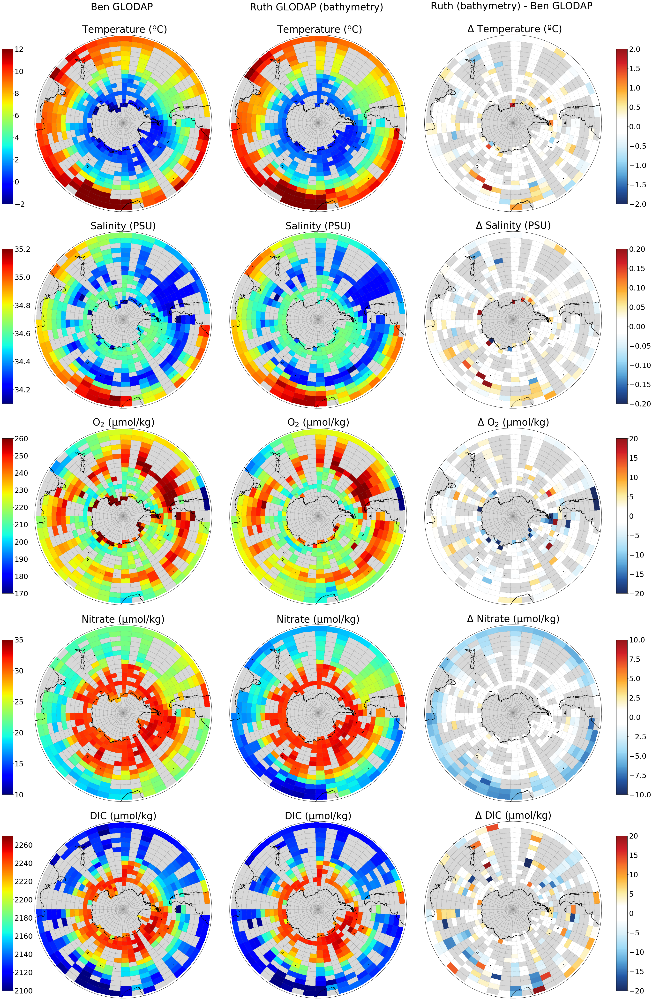

In [64]:
fig = plt.figure(figsize=[42, 74])
gs = gridspec.GridSpec(5,3)
proj = ccrs.Stereographic(central_longitude=-150,central_latitude=-90)
ax, ax1, ax2, ax3, ax4, ax5,ax6,ax7,ax8,ax9, ax10,ax11,ax12,ax13,ax14 = plt.subplot(gs[0,0], projection =proj), plt.subplot(gs[0,1], projection =proj), plt.subplot(gs[0,2], projection =proj),plt.subplot(gs[1,0], projection =proj),plt.subplot(gs[1,1], projection =proj),plt.subplot(gs[1,2], projection =proj),plt.subplot(gs[2,0], projection =proj),plt.subplot(gs[2,1], projection =proj),plt.subplot(gs[2,2], projection =proj),plt.subplot(gs[3,0], projection =proj),plt.subplot(gs[3,1], projection =proj),plt.subplot(gs[3,2], projection =proj),plt.subplot(gs[4,0], projection =proj),plt.subplot(gs[4,1], projection =proj),plt.subplot(gs[4,2], projection =proj)

gs.update(wspace = 0.1, hspace = 0.05)

cmap = pcm.jet
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=12) 
temp = plot_ben_grid(ax, Ben_GLODAP_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax.set_title('Ben GLODAP \n \n Temperature (ºC)', fontsize = 40)
plot_ben_grid(ax1, Ruth_GLODAP_bathy_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax1.set_title('Ruth GLODAP (bathymetry) \n \n Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.08, 0.745, 0.015, 0.12])
cbar=plt.colorbar(temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=34.1,vmax=35.2) 
salt = plot_ben_grid(ax3, Ben_GLODAP_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax3.set_title('Salinity (PSU)', fontsize = 40)
plot_ben_grid(ax4, Ruth_GLODAP_bathy_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax4.set_title('Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.08, 0.59, 0.015, 0.12])
cbar=plt.colorbar(salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=170,vmax=260) 
oxyg = plot_ben_grid(ax6, Ben_GLODAP_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax6.set_title('O$_2$ (µmol/kg)', fontsize = 40)
plot_ben_grid(ax7, Ruth_GLODAP_bathy_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax7.set_title('O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.443, 0.015, 0.12])
cbar=plt.colorbar(oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=10,vmax=35) 
nitr = plot_ben_grid(ax9, Ben_GLODAP_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax9.set_title('Nitrate (µmol/kg)', fontsize = 40)
plot_ben_grid(ax10, Ruth_GLODAP_bathy_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax10.set_title('Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.287, 0.015, 0.12])
cbar=plt.colorbar(nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=2100,vmax=2270) 
dic = plot_ben_grid(ax12, Ben_GLODAP_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax12.set_title('DIC (µmol/kg)', fontsize = 40)
plot_ben_grid(ax13, Ruth_GLODAP_bathy_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax13.set_title('DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.135, 0.015, 0.12])
cbar=plt.colorbar(dic,cax = cax,orientation='vertical',shrink = 0.5)

cmap = nclcmaps.cmap('BlueWhiteOrangeRed')
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=2) 
anom_temp = plot_ben_grid(ax2, anomaly_GLODAP_bathy_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax2.set_title('Ruth (bathymetry) - Ben GLODAP \n \n $\Delta$ Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.92, 0.745, 0.015, 0.12])
cbar=plt.colorbar(anom_temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-0.2,vmax=0.2) 
anom_salt = plot_ben_grid(ax5, anomaly_GLODAP_bathy_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax5.set_title('$\Delta$ Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.92, 0.59, 0.015, 0.12])
cbar=plt.colorbar(anom_salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_oxyg = plot_ben_grid(ax8, anomaly_GLODAP_bathy_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax8.set_title('$\Delta$ O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.443, 0.015, 0.12])
cbar=plt.colorbar(anom_oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-10,vmax=10) 
anom_nitr = plot_ben_grid(ax11, anomaly_GLODAP_bathy_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax11.set_title('$\Delta$ Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.287, 0.015, 0.12])
cbar=plt.colorbar(anom_nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_dic = plot_ben_grid(ax14, anomaly_GLODAP_bathy_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax14.set_title('$\Delta$ DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.135, 0.015, 0.12])
cbar=plt.colorbar(anom_dic,cax = cax,orientation='vertical',shrink = 0.5)

figurepath = 'SF2-GLODAP-comparison-bathymetry.png'
plt.savefig(figurepath, dpi=None, facecolor='w', edgecolor='w',orientation='portrait', papertype=None, format='png',transparent=False, bbox_inches='tight', pad_inches=0.1,frameon=None)


plt.show()

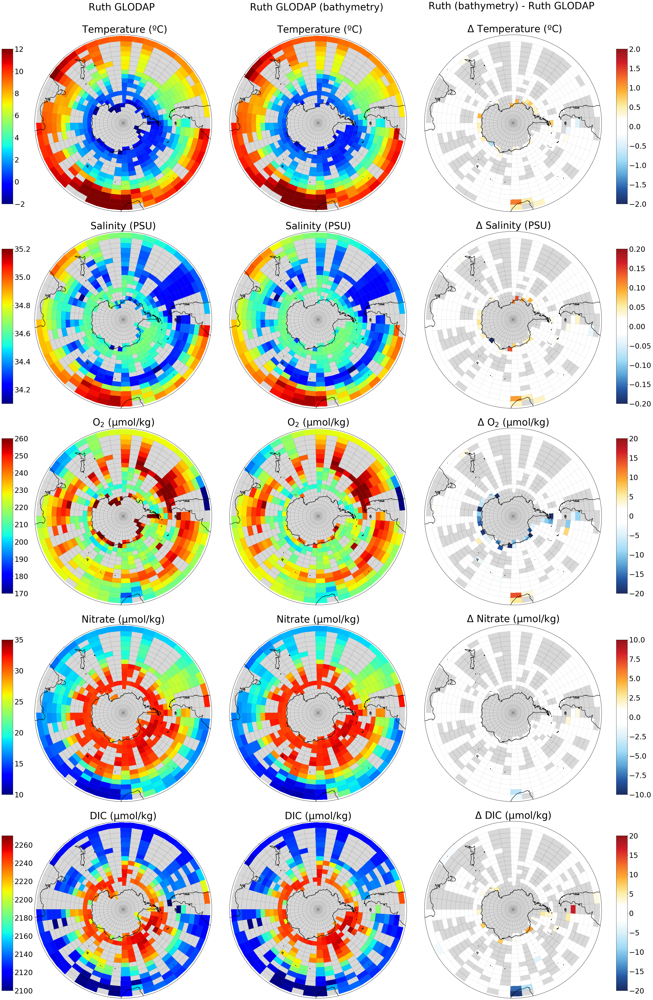

In [65]:
fig = plt.figure(figsize=[42, 74])
gs = gridspec.GridSpec(5,3)
proj = ccrs.Stereographic(central_longitude=-150,central_latitude=-90)
ax, ax1, ax2, ax3, ax4, ax5,ax6,ax7,ax8,ax9, ax10,ax11,ax12,ax13,ax14 = plt.subplot(gs[0,0], projection =proj), plt.subplot(gs[0,1], projection =proj), plt.subplot(gs[0,2], projection =proj),plt.subplot(gs[1,0], projection =proj),plt.subplot(gs[1,1], projection =proj),plt.subplot(gs[1,2], projection =proj),plt.subplot(gs[2,0], projection =proj),plt.subplot(gs[2,1], projection =proj),plt.subplot(gs[2,2], projection =proj),plt.subplot(gs[3,0], projection =proj),plt.subplot(gs[3,1], projection =proj),plt.subplot(gs[3,2], projection =proj),plt.subplot(gs[4,0], projection =proj),plt.subplot(gs[4,1], projection =proj),plt.subplot(gs[4,2], projection =proj)

gs.update(wspace = 0.1, hspace = 0.05)

cmap = pcm.jet
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=12) 
temp = plot_ben_grid(ax,Ruth_GLODAP_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax.set_title('Ruth GLODAP \n \n Temperature (ºC)', fontsize = 40)
plot_ben_grid(ax1, Ruth_GLODAP_bathy_Temp_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax1.set_title('Ruth GLODAP (bathymetry) \n \n Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.08, 0.745, 0.015, 0.12])
cbar=plt.colorbar(temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=34.1,vmax=35.2) 
salt = plot_ben_grid(ax3,Ruth_GLODAP_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax3.set_title('Salinity (PSU)', fontsize = 40)
plot_ben_grid(ax4, Ruth_GLODAP_bathy_Salt_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax4.set_title('Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.08, 0.59, 0.015, 0.12])
cbar=plt.colorbar(salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=170,vmax=260) 
oxyg = plot_ben_grid(ax6,Ruth_GLODAP_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax6.set_title('O$_2$ (µmol/kg)', fontsize = 40)
plot_ben_grid(ax7, Ruth_GLODAP_bathy_Oxygen_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax7.set_title('O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.443, 0.015, 0.12])
cbar=plt.colorbar(oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=10,vmax=35) 
nitr = plot_ben_grid(ax9,Ruth_GLODAP_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax9.set_title('Nitrate (µmol/kg)', fontsize = 40)
plot_ben_grid(ax10, Ruth_GLODAP_bathy_Nitrate_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax10.set_title('Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.287, 0.015, 0.12])
cbar=plt.colorbar(nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=2100,vmax=2270) 
dic = plot_ben_grid(ax12,Ruth_GLODAP_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax12.set_title('DIC (µmol/kg)', fontsize = 40)
plot_ben_grid(ax13, Ruth_GLODAP_bathy_DIC_1000m, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax13.set_title('DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.08, 0.135, 0.015, 0.12])
cbar=plt.colorbar(dic,cax = cax,orientation='vertical',shrink = 0.5)

cmap = nclcmaps.cmap('BlueWhiteOrangeRed')
cmap.set_bad('grey',0.3)

norm = col.Normalize(vmin=-2,vmax=2) 
anom_temp = plot_ben_grid(ax2, bathy_effect_GLODAP_temp, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax2.set_title('Ruth (bathymetry) - Ruth GLODAP \n \n $\Delta$ Temperature (ºC)', fontsize = 40)
cax = fig.add_axes([0.92, 0.745, 0.015, 0.12])
cbar=plt.colorbar(anom_temp,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-0.2,vmax=0.2) 
anom_salt = plot_ben_grid(ax5, bathy_effect_GLODAP_salt, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax5.set_title('$\Delta$ Salinity (PSU)', fontsize = 40)
cax = fig.add_axes([0.92, 0.59, 0.015, 0.12])
cbar=plt.colorbar(anom_salt,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_oxyg = plot_ben_grid(ax8, bathy_effect_GLODAP_oxyg, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax8.set_title('$\Delta$ O$_2$ (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.443, 0.015, 0.12])
cbar=plt.colorbar(anom_oxyg,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-10,vmax=10) 
anom_nitr = plot_ben_grid(ax11, bathy_effect_GLODAP_nitr, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax11.set_title('$\Delta$ Nitrate (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.287, 0.015, 0.12])
cbar=plt.colorbar(anom_nitr,cax = cax,orientation='vertical',shrink = 0.5)

norm = col.Normalize(vmin=-20,vmax=20) 
anom_dic = plot_ben_grid(ax14, bathy_effect_GLODAP_dic, cmap, lon = np.arange(0,361,8), lat = np.arange(-90,-29,3))
ax14.set_title('$\Delta$ DIC (µmol/kg)', fontsize = 40)
cax = fig.add_axes([0.92, 0.135, 0.015, 0.12])
cbar=plt.colorbar(anom_dic,cax = cax,orientation='vertical',shrink = 0.5)

figurepath = 'SF2-GLODAP-bathymetry-effect.png'
plt.savefig(figurepath, dpi=None, facecolor='w', edgecolor='w',orientation='portrait', papertype=None, format='png',transparent=False, bbox_inches='tight', pad_inches=0.1,frameon=None)


plt.show()